<a href="https://colab.research.google.com/github/juampismon/IAHR24_LISBON/blob/main/01_EDA_LULC_CHANGE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Land cover change analysis from an hydrological perspective using Copernicus products: Working in __"The Cloud"__ (_i.e. someone else's computer._)
---
*Author: garciamonjp@unican.es* ✉ | **[IHCantabria](https://ihcantabria.com/en/)** |  Date: 03/06/2024 | WARISKAN-COP: Water Risk Analysis Based on Copernicus -   2020-2-26 - Specific Grant Agreement Nº17


Today, we are going to use [Google Colab](https://colab.research.google.com/) and [Google Drive](https://www.google.com/drive/) as platforms to run code and store files without the need to install or download anything on our local machine.

<style>
td, th {
   border: 1px solid white;
   border-collapse: collapse;
}
</style>
<table align="left">
  <tr>
    <th>Run the tutorial via Colab: </th>
    <th><a href="https://colab.research.google.com/">
        <img src = "https://colab.research.google.com/assets/colab-badge.svg" alt = "Colab"></th>
  </tr>
</table>



> Explore other interesting alternatives like [Wekeo's services (i.e. JupyterHub and Wekeo Drive)](https://www.wekeo.eu/services) to access and work with Copernicus data directly from the original sources while taking advantage of an infrastructure and services designed for it, or [Kaggle](https://www.kaggle.com/) to keep up to date with this huge AI and ML community.

# Getting, exploring and sharing data

## Download data using the __Wekeo's _Harmonized Data Access_ (HDA) API__ (_Users already registered on Wekeo_)
> You can create an account following the instructions given on the [Wekeo website](https://www.wekeo.eu/register).

The [HDA API Python Client](https://help.wekeo.eu/en/articles/6751608-what-is-the-hda-api-python-client-and-how-to-use-it) will help us to download and process Wekeo's Copernicus data.

__Some concepts in a nutshell:__

> __Wekeo & Copernicus:__ [Copernicus](https://www.copernicus.eu/en/about-copernicus) is an European Union's Space programme aimed at developing European information services based on satellite Earth Observation and in situ (non space) data. Wekeo is one of five Data and Information Access Services (DIAS) that provide centralised access to Copernicus Sentinel data, as well as to information products from the six Copernicus operational services (Atmosphere, Marine, Land, Climate Change, Security and Emergency). Data from Wekeo catalogue can be downloaded via two methods: from the [data viewer](https://www.wekeo.eu/data?view=catalogue&initial=1) directly or via the [HDA API](https://help.wekeo.eu/en/collections/3530725-wekeo-harmonized-data-access) in a script.

> __HDA API:__ When we people want to interact with a computer program, we use a _User Interface_ (UI). In contrast, an _Application Programming Interface_ (API) is a way in which two or more computer programs can interact with each other. A Python API Client is a tool for making requests to the API via Python and is called a "client" because it is what uses the services provided by the API.

### Install the hda module and set up the HDA Client

In [1]:
# Install the latest version of hda
!pip install hda -U

  Preparing metadata (setup.py) ... done
  Created wheel for hda: filename=hda-2.14-py3-none-any.whl size=15156 sha256=7c7c15ee2411ad3a27ab91c70de0747ca55b5d7d1634f7fd5804c8860f58f261
  Stored in directory: /root/.cache/pip/wheels/f0/b9/9c/ebfae7fbd338f77aa889fa40cc39d21b0eb5360d564356b08e
Successfully built hda


In [2]:
# Import the needed functions from the hda module
from hda import Client, Configuration

> The followoing method needs to be done only once. Future calls `hda_client = Client()` will always retrieve credentials from created file (the _$HOME/.hdarc_ file in your Unix/Linux environment).  

In [3]:
# Configure credentials and load hda Client
### Create the .hdarc configuration file as follows:
from pathlib import Path

# Default location expected by hda package
hdarc = Path(Path.home() / '.hdarc')

# Create or re-write the .hdarc file
import getpass
USERNAME = input('Enter your username: ')
PASSWORD = getpass.getpass('Enter your password: ')

with open(Path.home() / '.hdarc', 'w') as f:
  f.write(f'user:{USERNAME}\n')
  f.write(f'password:{PASSWORD}\n')

### Load the hda client using the default .hdarc file for getting your credentials
hda_client = Client()

Enter your username: garciamonjp
Enter your password: ··········


When you are working on your usual machine, you may do this only once. So it would be enough to check that the .hdarc file exists.

Here is an example code:

```python
from pathlib import Path

# Default location expected by hda package
hdarc = Path(Path.home() / '.hdarc')

# Create the .hdarc file only if it does not already exists
if not hdarc.is_file():
    import getpass
    USERNAME = input('Enter your username: ')
    PASSWORD = getpass.getpass('Enter your password: ')

    with open(Path.home() / '.hdarc', 'w') as f:
        f.write(f'user:{USERNAME}\n')
        f.write(f'password:{PASSWORD}\n')
    print('.hdarc file has been created successfully')
else:
    print('.hdarc file already exists')

    ### This code is in a text cell, it's not excecutable ###
```

> For more information on client configuration, see the [hda documentation](https://hda.readthedocs.io/en/latest/usage.html).

### Download the CORINE Land Cover (CLC) __change map__ for 2012-2018

First, we can take a look at the datasets available for this product with the help of the [Data viewer](https://www.wekeo.eu/data?view=catalogue&initial=1). In addition, we can get the query to request the data via the HDA API:
1.   Type in the free text search bar "CORINE".
2.   Click on the __Add to map__ button corresponding to the CORINE Land Cover dataset.
3. Click on the __Subset and download__ button.
 - Log in to the Wekeo platform, if the login window has been displayed.
4. Select _Corine Land Change 2012 2018_ (The most recent update) in the __Product type__ box and _GeoPackage_ in the __Format__ box.
5. Click on the __Show API request(s)__ button.
6. Copy the query in JSON format.

> The CORINE Land Cover has become a flagship component of the Copernicus Land Monitoring Service (CLMS).


In [4]:
# Paste the JSON query to load into the "query" variable
query = {
  "datasetId": "EO:CLMS:DAT:CORINE",
  "stringChoiceValues": [
    {
      "name": "product_type",
      "value": "Corine Land Change 2012 2018"
    },
    {
      "name": "format",
      "value": "GeoPackage"
    }
  ]
}

The API response to your query is a list of results that you have access to and that match your query. Several actions can be requested for these results, e.g. downloading them or consulting their metadata.

In [5]:
# Ask and check the results for the query
matches = hda_client.search(query)
print(matches)

### Note Error 403 may mean that your credentials were wrong when configure the hda client. Stop the process and then you may re-write the .hdarc file ###

SearchResults[items=1,volume=112.7MB]


> Different data can be requested by changing some values for the query elements.

> WARNING_NOTE: We are still using the HDA v1 format because is the one we can get from dataviewer.

Each dataset or group of datasets has a __dataset id__, in this case we can identify it in the first element of the query `"datasetId": "EO:CLMS:DAT:CORINE"`.

We can query what we have available for this dataset using the `.metadata` method.

In [6]:
metadata_CLC_ds = hda_client.metadata("EO:CLMS:DAT:CORINE")
metadata_CLC_ds

{'type': 'object',
 'title': 'Querable',
 'properties': {'dataset_id': {'title': 'Dataset_id',
   'type': 'string',
   'oneOf': [{'const': 'EO:CLMS:DAT:CORINE',
     'title': 'EO:CLMS:DAT:CORINE',
     'group': None}]},
  'product_type': {'title': 'Product Type',
   'type': 'string',
   'oneOf': [{'const': 'Corine Land Change 2006 2012',
     'title': 'Corine Land Change 2006 2012',
     'group': None},
    {'const': 'Corine Land Change 2000 2006',
     'title': 'Corine Land Change 2000 2006',
     'group': None},
    {'const': 'Corine Land Cover 2000',
     'title': 'Corine Land Cover 2000',
     'group': None},
    {'const': 'Corine Land Change 2012 2018',
     'title': 'Corine Land Change 2012 2018',
     'group': None},
    {'const': 'Corine Land Cover 2018',
     'title': 'Corine Land Cover 2018',
     'group': None},
    {'const': 'Corine Land Change 1990 2000',
     'title': 'Corine Land Change 1990 2000',
     'group': None},
    {'const': 'Corine Land Cover 2012',
     'title'

Download the file `u2018_cha1218_v2020_20u1_geoPackage.zip` correspondig to the dataset [CORINE Land Cover Change 2012-2018 (vector/raster 100 m), Europe, 6-yearly](https://land.copernicus.eu/en/products/corine-land-cover/lcc-2012-2018) in GeoPackage format.
> This product provides land cover __change__ information between the __2012 and 2018 CLC status layers__.

In [7]:
# Download results in a directory
# Since version 1.14 of hda, the directory is created if it doesn't exist - 1 min
matches.download(download_dir="./temp/CLC")

Now, you can see the created folder and the downloaded file.
> Click on the folder icon in the left side of your screen (_click on the refresh icon if you can't see the_ ___temp___ _folder_).


> The file has been downloaded to Colab's virtual machine, this means that they are not located on your computer.

> Remember that data can be downloaded directly from the data viewer.

### Download the EU-Hydro dataset


The [EU-Hydro](https://land.copernicus.eu/en/products/eu-hydro/eu-hydro-river-network-database) dataset provides a photo-interpreted river network, consistent of surface interpretation of water bodies (lakes and wide rivers), and a drainage model (also called Drainage Network), derived from EU-DEM, with catchments and drainage lines and nodes.

In [8]:
# Take a look at the dataset metadata
metadata_HYDRO_ds = hda_client.metadata("EO:CLMS:DAT:EU-HYDRO")
metadata_HYDRO_ds

{'type': 'object',
 'title': 'Querable',
 'properties': {'dataset_id': {'title': 'Dataset_id',
   'type': 'string',
   'oneOf': [{'const': 'EO:CLMS:DAT:EU-HYDRO',
     'title': 'EO:CLMS:DAT:EU-HYDRO',
     'group': None}]},
  'product_type': {'title': 'Product Type',
   'type': 'string',
   'oneOf': [{'const': 'River Network Database',
     'title': 'River Network Database',
     'group': None},
    {'const': 'Coastline', 'title': 'Coastline', 'group': None}]},
  'format': {'title': 'Format',
   'type': 'string',
   'oneOf': [{'const': 'ShapeFile', 'title': 'ShapeFile', 'group': None},
    {'const': 'GeoPackage', 'title': 'GeoPackage', 'group': None},
    {'const': 'ESRI File Geodatabase',
     'title': 'ESRI File Geodatabase',
     'group': None}]}},
 'required': ['dataset_id']}

In this case we are interested in the __River Network Database__, but notice that a __Coastline__ product is also available.

In [9]:
# Set the "query" variable
query = {
  "datasetId": "EO:CLMS:DAT:EU-HYDRO",
  "stringChoiceValues": [
    {
      "name": "product_type",
      "value": "River Network Database"
    },
    {
      "name": "format",
      "value": "GeoPackage"
    }
  ]
}
# Configure the client not to show download progress
hda_client_NP = Client(progress=False)
# Ask and check the results for the query
matches = hda_client_NP.search(query)
print(matches)

SearchResults[items=35,volume=4.1GB]


In [ ]:
matches.results # Results for the query

[{'type': 'Feature',
  'properties': {'startdate': '2020-09-04T10:41:20Z',
   'enddate': '2020-09-04T10:41:20Z',
   'location': 'https://cws-download.eea.europa.eu/pan-european/satellite_derived/eu_hydro/EU_Hydro_V012/GeoPackage/euhydro_angerman_v012_GPKG.zip',
   'size': 197148603,
   'dataprovider': 'EEA',
   'localpath': 'https://cws-download.eea.europa.eu/pan-european/satellite_derived/eu_hydro/EU_Hydro_V012/GeoPackage/euhydro_angerman_v012_GPKG.zip'},
  'id': 'euhydro_angerman_v012_GPKG'},
 {'type': 'Feature',
  'properties': {'startdate': '2020-09-04T10:44:45Z',
   'enddate': '2020-09-04T10:44:45Z',
   'location': 'https://cws-download.eea.europa.eu/pan-european/satellite_derived/eu_hydro/EU_Hydro_V012/GeoPackage/euhydro_danube_v012_GPKG.zip',
   'size': 559861702,
   'dataprovider': 'EEA',
   'localpath': 'https://cws-download.eea.europa.eu/pan-european/satellite_derived/eu_hydro/EU_Hydro_V012/GeoPackage/euhydro_danube_v012_GPKG.zip'},
  'id': 'euhydro_danube_v012_GPKG'},
 {'typ

Let's take a look at the files available for download.
> The EU-Hydro dataset is compund by 35 subsets. The Layout of the subsets considers geographic connectedness and the footprints of major drainage basins.

> From now on, the so-called Major Basin (influence) Zones (MBZs) are named after the main basin within the zone of influence, but this does not imply that the MBZ and the basin are one and the same.

> The client has been set to silent, so it will not show the dowload progress as before.

In [10]:
id_list = [dataset['id'] for dataset in matches.results]
id_list

['euhydro_angerman_v012_GPKG',
 'euhydro_danube_v012_GPKG',
 'euhydro_duero_v012_GPKG',
 'euhydro_ebro_v012_GPKG',
 'euhydro_elbe_v012_GPKG',
 'euhydro_fr_guiana_v012_GPKG',
 'euhydro_fr_islands_v012_GPKG',
 'euhydro_garonne_v012_GPKG',
 'euhydro_gota_v012_GPKG',
 'euhydro_guadalquivir_v012_GPKG',
 'euhydro_hondo_v012_GPKG',
 'euhydro_iceland_v012_GPKG',
 'euhydro_jucar_v012_GPKG',
 'euhydro_kemi_v012_GPKG',
 'euhydro_loire_v012_GPKG',
 'euhydro_mesima_v012_GPKG',
 'euhydro_nemunas_v012_GPKG',
 'euhydro_neva_v012_GPKG',
 'euhydro_oder_v012_GPKG',
 'euhydro_pinios_v012_GPKG',
 'euhydro_po_v012_GPKG',
 'euhydro_rhine_v012_GPKG',
 'euhydro_rhone_v012_GPKG',
 'euhydro_seine_v012_GPKG',
 'euhydro_shannon_v012_GPKG',
 'euhydro_skjern_v012_GPKG',
 'euhydro_tajo_v012_GPKG',
 'euhydro_tana_v012_GPKG',
 'euhydro_tevere_v012_GPKG',
 'euhydro_thames_v012_GPKG',
 'euhydro_tirso_v012_GPKG',
 'euhydro_turkey_v012_GPKG',
 'euhydro_tweed_v012_GPKG',
 'euhydro_vistula_v012_GPKG',
 'euhydro_vorma_v012_GP

We are going to download only the files corresponding to zones of influence of major drainage basins within the Iberian Peninsula.

This are the subsets:

*   __Duero__, zone of influence of the _Douro river basin_.
*   __Ebro__, zone of influence of the _Ebro river basin_.
*   __Guadalquivir__, zone of influence of the _Guadalquivir river basin_.
*   __Jucar__, zone of influence of the _Júcar river basin_.
*   __Tajo__, zone of influence of the _Tagus river basin_.

In [11]:
search_strings = ['euhydro_duero_v012_GPKG',
                  'euhydro_ebro_v012_GPKG',
                  'euhydro_guadalquivir_v012_GPKG',
                  'euhydro_jucar_v012_GPKG',
                  'euhydro_tajo_v012_GPKG']

# Find indices of elements that match any of the search strings
matching_indices = [index for index, dataset in enumerate(matches.results) if dataset['id'] in search_strings]

# Print the matching indices
print("Matching indices:", matching_indices)

Matching indices: [2, 3, 9, 12, 26]


In [12]:
# Download
for ind in matching_indices:
  matches[ind].download(download_dir="./temp/EU_HYDRO")

## Let's take a look of some of the files downloaded
We will use the [GeopPandas](https://geopandas.org/en/stable/index.html) and [Matplolib](https://matplotlib.org/) libraries to work with and visualise the geospatial information we have downloaded. But first, we need to unzip the files


### Unzip the files

Unzip the __CLC Change__ downloaded files using the command `!unzip`

In [13]:
# Specify _the path to the files_ to be unzipped and the directory in which they will be unzipped.
!unzip /content/temp/CLC/u2018_cha1218_v2020_20u1_geoPackage.zip -d /content/temp/CLC

Archive:  /content/temp/CLC/u2018_cha1218_v2020_20u1_geoPackage.zip
  inflating: /content/temp/CLC/u2018_cha1218_v2020_20u1_geoPackage/DATA/U2018_CHA1218_V2020_20u1.gpkg  
  inflating: /content/temp/CLC/u2018_cha1218_v2020_20u1_geoPackage/Documents/readme_V2020_20u1_vector.txt  
  inflating: /content/temp/CLC/u2018_cha1218_v2020_20u1_geoPackage/Documents/readme_U2018_CHA1218_V2020_20u1.txt  
  inflating: /content/temp/CLC/u2018_cha1218_v2020_20u1_geoPackage/Documents/How use ESRI FGDB in QGIS.doc  
  inflating: /content/temp/CLC/u2018_cha1218_v2020_20u1_geoPackage/Documents/readme_U2018_CHA1218_V2020_20u1_FR_GLP.txt  
  inflating: /content/temp/CLC/u2018_cha1218_v2020_20u1_geoPackage/Documents/clc-and-clcc-release-lineage-v20u1.pdf  
  inflating: /content/temp/CLC/u2018_cha1218_v2020_20u1_geoPackage/Documents/clc-country-coverage-1990-2018-v20u1.pdf  
  inflating: /content/temp/CLC/u2018_cha1218_v2020_20u1_geoPackage/Documents/clc-country-coverage-1990-2018-v20u1.xls  
  inflating: /co

Unzip all files in the __EU_HYDRO__ folder

In [14]:
### The following code is using linux commands directly ###
# Remember, we are working in a Colab virtual machine, so the operating system (OS) is linux.
!cd temp/EU_HYDRO/ ; unzip '*.zip' -d /content/temp/EU_HYDRO; pwd #Commands are written on the same line because each line break resets to the previous state.

Archive:  euhydro_tajo_v012_GPKG.zip
  inflating: /content/temp/EU_HYDRO/euhydro_tajo_v012_GPKG/euhydro_tajo_v012.gpkg  
  inflating: /content/temp/EU_HYDRO/euhydro_tajo_v012_GPKG/drainage_network_tajo_public_beta_v009.gpkg  
  inflating: /content/temp/EU_HYDRO/euhydro_tajo_v012_GPKG/Documentation/EU-HYDRO_V1p2_User_Guide.pdf  
  inflating: /content/temp/EU_HYDRO/euhydro_tajo_v012_GPKG/Documentation/How_use_ESRI_FGDB_in_QGIS.pdf  
  inflating: /content/temp/EU_HYDRO/euhydro_tajo_v012_GPKG/Metadata/tajo_metadata.xml  

Archive:  euhydro_duero_v012_GPKG.zip
  inflating: /content/temp/EU_HYDRO/euhydro_duero_v012_GPKG/euhydro_duero_v012.gpkg  
  inflating: /content/temp/EU_HYDRO/euhydro_duero_v012_GPKG/drainage_network_duero_public_beta_v009.gpkg  
  inflating: /content/temp/EU_HYDRO/euhydro_duero_v012_GPKG/Documentation/EU-HYDRO_V1p2_User_Guide.pdf  
  inflating: /content/temp/EU_HYDRO/euhydro_duero_v012_GPKG/Documentation/How_use_ESRI_FGDB_in_QGIS.pdf  
  inflating: /content/temp/EU_HYDR

> Below are shown a command to change the directory `cd` and another to print the current working directory `pdw`. See what was commented earlier about the reseting by line break.

In [15]:
!cd temp/EU_HYDRO; pwd
!pwd

/content/temp/EU_HYDRO
/content


### Load the Tajo basins data to a GeoDataFrame using Geopandas

Load the Tajo basins dataset from the `drainage_network_tajo_public_beta_v009.gpkg` file, layer `tajo_eudem2_basins`.
> We need to import [__fiona__](https://pypi.org/project/fiona/) and __GeoPandas__  modules, but unlike the __hda__ module we don't need to install them as the Colab environment already has these libraries pre-installed. The Colab environment has other scientific and machine learning packages pre-installed, such as [numpy](https://numpy.org/), [scipy](https://scipy.org/), [pandas](https://pandas.pydata.org/), [tensorflow](https://www.tensorflow.org/), [pytorch](https://pytorch.org/) or [keras](https://keras.io/).


> Although for this case it is possible to read the geopackage without specifying the layer, the conventional way is to read the geopackage layer by layer. We are going to use the __fiona__ module to list the geopackage layers.


In [16]:
# List layers of the Tajo basins geopackage
import fiona
# Path to the file
tajo_basins_path = '/content/temp/EU_HYDRO/euhydro_tajo_v012_GPKG/drainage_network_tajo_public_beta_v009.gpkg'
# List layers
layers = fiona.listlayers(tajo_basins_path)
# Print
print(layers)

['tajo_eudem2_basins', 'tajo_eudem2_basins_h1', 'tajo_eudem2_basins_h2', 'tajo_eudem2_basins_h3', 'tajo_eudem2_basins_h4', 'tajo_eudem2_basins_h5', 'tajo_eudem2_basins_h6', 'tajo_eudem2_basins_h7']


In [17]:
# List layers of the Tajo basins geopackage
import fiona
# Path to the file
tajo_rivers_path = '/content/temp/EU_HYDRO/euhydro_tajo_v012_GPKG/euhydro_tajo_v012.gpkg'
# List layers
layers = fiona.listlayers(tajo_rivers_path)
# Print
print(layers)

['Canals_p', 'Coastal_p', 'Culverts', 'Ditches_p', 'InlandWater', 'River_Net_p', 'RiverBasins', 'Transit_p', 'Nodes', 'Canals_l', 'Ditches_l', 'River_Net_l']


> We are going to install the [pyogrio](https://pyogrio.readthedocs.io/en/latest/about.html) library to be able to use the pyogrio IO engine for geopandas. This may speed up the reading and writing of files.

In [18]:
# Install pyogrio
!pip install pyogrio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.1/23.1 MB 50.0 MB/s eta 0:00:00


 > __Note:__ [pyarrow]() must be installed for you to specify `use_arrow =  True`. (Check when you are using your machine).

In [19]:
import geopandas as gpd
# Read files using GeoPandas
tajo_basins_gdf = gpd.read_file(tajo_basins_path, layer='tajo_eudem2_basins', engine= 'pyogrio', use_arrow=True)
# Show the GeoDataFrame tabular data
tajo_basins_gdf

,namebasin,h1_id,h2_id,h3_id,h4_id,h5_id,h6_id,h7_id,PFAFSTETER,geometry
0,Tajo,EU1H100571,None,None,None,None,None,None,None,"MULTIPOLYGON (((2739300.000 1733000.000, 27393..."
1,Tajo,EU1H100570,EU1H206166,None,None,None,None,None,None,"MULTIPOLYGON (((2747750.000 1736825.000, 27477..."
2,Tajo,EU1H100563,EU1H206135,None,None,None,None,None,None,"MULTIPOLYGON (((2763225.000 1743375.000, 27631..."
3,Tajo,EU1H100569,None,None,None,None,None,None,None,"MULTIPOLYGON (((2719457.484 1743680.528, 27193..."
4,Tajo,EU1H100564,EU1H206120,None,None,None,None,None,None,"MULTIPOLYGON (((2793330.666 1743558.269, 27933..."
...,...,...,...,...,...,...,...,...,...,...
7718,Tajo,EU1H100348,EU1H202764,EU1H304705,None,None,None,None,None,"MULTIPOLYGON (((3126925.000 2059200.000, 31268..."
7719,Tajo,EU1H100348,EU1H202422,EU1H305816,None,None,None,None,None,"MULTIPOLYGON (((3187500.000 2003800.000, 31873..."
7720,Tajo,EU1H100566,None,None,None,None,None,None,None,"MULTIPOLYGON (((2777857.484 1746905.528, 27778..."
7721,Tajo,EU1H100566,None,None,None,None,None,None,None,"MULTIPOLYGON (((2777816.561 1746929.801, 27778..."


Since we are dealing with geographic information, we must know the Coordinate Reference System (CRS).

In [20]:
# Show CRS data
tajo_basins_gdf.crs

<Projected CRS: EPSG:3035>
Name: ETRS89-extended / LAEA Europe
Axis Info [cartesian]:
- Y[north]: Northing (metre)
- X[east]: Easting (metre)
Area of Use:
- name: Europe - European Union (EU) countries and candidates. Europe - onshore and offshore: Albania; Andorra; Austria; Belgium; Bosnia and Herzegovina; Bulgaria; Croatia; Cyprus; Czechia; Denmark; Estonia; Faroe Islands; Finland; France; Germany; Gibraltar; Greece; Hungary; Iceland; Ireland; Italy; Kosovo; Latvia; Liechtenstein; Lithuania; Luxembourg; Malta; Monaco; Montenegro; Netherlands; North Macedonia; Norway including Svalbard and Jan Mayen; Poland; Portugal including Madeira and Azores; Romania; San Marino; Serbia; Slovakia; Slovenia; Spain including Canary Islands; Sweden; Switzerland; Türkiye (Turkey); United Kingdom (UK) including Channel Islands and Isle of Man; Vatican City State.
- bounds: (-35.58, 24.6, 44.83, 84.73)
Coordinate Operation:
- name: Europe Equal Area 2001
- method: Lambert Azimuthal Equal Area
Datum: Eur

Visualise the dataset by plotting using __Matplotlib__

<Axes: >

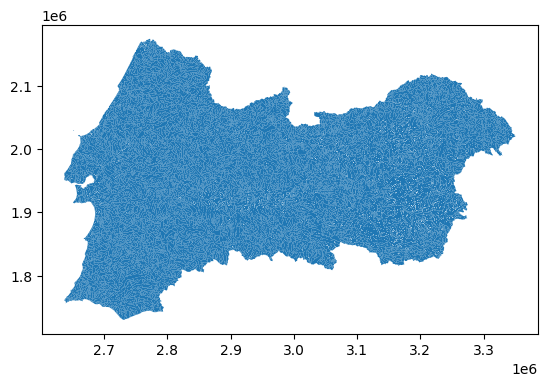

In [21]:
# Plot the geodatafrme
tajo_basins_gdf.plot()

### Load CORINE Land Cover Change (2012-2018) data

See which layers are contained in the CORINE Land Cover Change (2012-2018) geopackage.
> The CORINE Land Cover Change (2012-2018) dataset includes overseas territories such as Guadeloupe

In [22]:
# List layers of the CORINE Land Cover Change (2012-2018) geopackage
# Path to the file
CLC_CHA_12_18_path = '/content/temp/CLC/u2018_cha1218_v2020_20u1_geoPackage/DATA/U2018_CHA1218_V2020_20u1.gpkg'
# List layers
layers = fiona.listlayers(CLC_CHA_12_18_path)
# Print
print(layers)

['U2018_CHA1218_V2020_20u1', 'U2018_CHA1218_V2020_20u1_FR_REU', 'U2018_CHA1218_V2020_20u1_FR_GLP', 'U2018_CHA1218_V2020_20u1_FR_GUF', 'U2018_CHA1218_V2020_20u1_FR_MTQ', 'U2018_CHA1218_V2020_20u1_FR_MYT']


Load the CLC Change dataset for Europe from the `U2018_CHA1218_V2020_20u1.gpkg` file, layer `U2018_CHA1218_V2020_20u1`.

In [23]:
### Load the goepackage layer using GeoPandas - 2minutes -> 5s
CLC_CHA_12_18_EUlayer = "U2018_CHA1218_V2020_20u1"
CLC_CHA_12_18_gdf = gpd.read_file(CLC_CHA_12_18_path, layer = CLC_CHA_12_18_EUlayer, engine= 'pyogrio', use_arrow=True)
CLC_CHA_12_18_gdf

,Change,ID,Code_12,Code_18,Chtype,Remark,Area_Ha,geometry
0,111-112,EU-1,111,112,R,None,8.049595,"MULTIPOLYGON (((1694293.310 1026426.510, 16942..."
1,111-112,EU-2,111,112,R,None,18.185013,"MULTIPOLYGON (((1693724.360 1026574.620, 16937..."
2,111-112,EU-3,111,112,R,None,12.212553,"MULTIPOLYGON (((6718070.640 1988846.820, 67180..."
3,111-121,EU-4,111,121,R,None,5.672068,"MULTIPOLYGON (((5940926.800 2105870.380, 59410..."
4,111-133,EU-5,111,133,R,None,8.844687,"MULTIPOLYGON (((6718460.140 1986936.760, 67185..."
...,...,...,...,...,...,...,...,...
388407,523-421,EU-388409,523,421,R,None,9.772401,"MULTIPOLYGON (((5329454.050 1765839.850, 53294..."
388408,523-511,EU-388410,523,511,R,None,269.729880,"MULTIPOLYGON (((3907870.910 3223746.420, 39075..."
388409,523-511,EU-388411,523,511,R,None,1.001409,"MULTIPOLYGON (((3910232.300 3224211.290, 39100..."
388410,523-511,EU-388412,523,511,R,None,476.607124,"MULTIPOLYGON (((3908995.190 3225039.400, 39090..."


Visualise the dataset by plotting using __Matplotlib__

<Axes: title={'center': 'CORINE Land Cover Change Locations (2012-2018) in Europe'}>

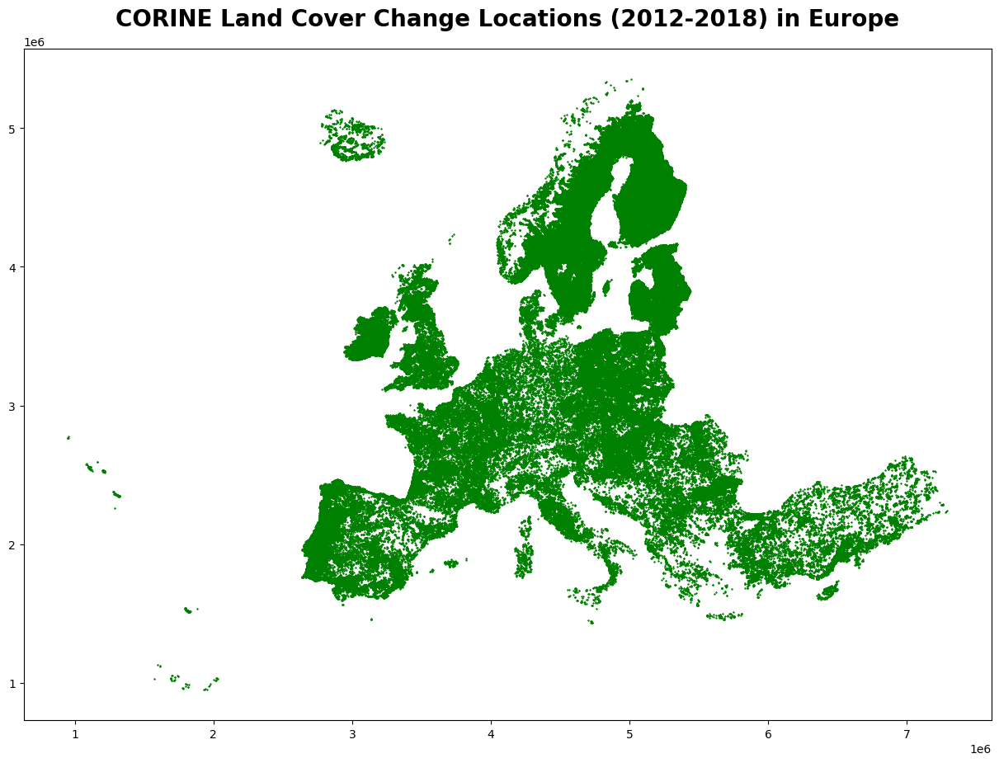

In [24]:
import matplotlib.pyplot as plt
# Plot using matplotlib and Geopandas
fig, ax = plt.subplots(figsize=(12, 12), layout='constrained')
ax.set_title('CORINE Land Cover Change Locations (2012-2018) in Europe', pad=20, fontsize = 20, fontweight='semibold');
# Make the GeoPandas plot
# Plot centroids
CLC_CHA_12_18_gdf.centroid.plot(ax=ax, marker='*', color='green', markersize=0.5)

### Visualize the land cover change near Lisbon

To visualise both maps at a reasonable scale, we will crop the GeoDataFrames to a defined area around Lisbon.

In [25]:
# Get the bounding box (extent) of the mask GeoDataFrame - 0s
bbox_nearLisbon = [2600000, 1900000, 2800000, 2100000]
bbox_nearLisbon

[2600000, 1900000, 2800000, 2100000]

Filter the maps based on the bounding box.

In [26]:
# Filter the Tajo basins GeoDataFrame based on the bounding box
basins_nLisbon = tajo_basins_gdf.cx[bbox_nearLisbon [0]:bbox_nearLisbon [2], bbox_nearLisbon [1]:bbox_nearLisbon [3]]
# Filter the CORINE Land Cover Change (2012-2018) GeoDataFrame based on the bounding box
CLC_change_nLisbon = CLC_CHA_12_18_gdf.cx[bbox_nearLisbon [0]:bbox_nearLisbon [2], bbox_nearLisbon [1]:bbox_nearLisbon [3]]

Creates a point with the location of Lisbon that can be seen on the map.

In [27]:
from shapely.geometry import Point

# Define the coordinates of Lisbon (in EPSG:4326, WGS84)
lisbon_lon, lisbon_lat = -9.1393, 38.7223

# Create a GeoDataFrame with a single point representing Lisbon
lisbon_point = Point(lisbon_lon, lisbon_lat)
lisbon_gdf = gpd.GeoDataFrame(geometry=[lisbon_point], crs='EPSG:4326')

# Project the GeoDataFrame to EPSG:3035
lisbon_gdf = lisbon_gdf.to_crs('EPSG:3035')

Plot everything together.

Text(3, -5, 'Lisbon')

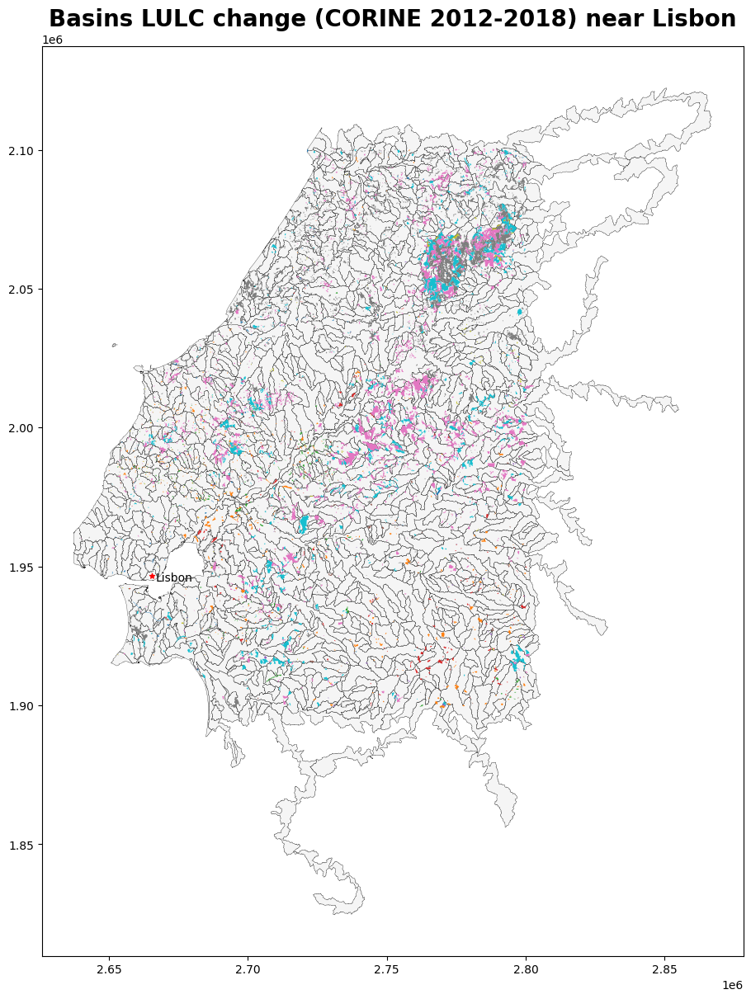

In [28]:
# Plot using matplotlib and GeoPandas
fig, ax = plt.subplots(figsize=(12, 12), layout='constrained')
ax.set_title('Basins LULC change (CORINE 2012-2018) near Lisbon', pad=18, fontsize = 20, fontweight='semibold');
# Make the GeoPandas plot
# Filter the GeoPackage based on the bounding box - 0s
tajo_basins_gdf.cx[bbox_nearLisbon [0]:bbox_nearLisbon [2], bbox_nearLisbon [1]:bbox_nearLisbon [3]].plot(ax=ax, color='whitesmoke', edgecolor='black', linewidth=0.2)
# Plot land cover change areas
CLC_CHA_12_18_gdf.cx[bbox_nearLisbon [0]:bbox_nearLisbon [2], bbox_nearLisbon [1]:bbox_nearLisbon [3]].plot(ax=ax, column="Change")
# Plot Lisbon location
lisbon_gdf.plot(ax=ax,color='red', marker='*', markersize=20)
# Annotate the point with the city name
plt.annotate('Lisbon', xy=(lisbon_gdf.geometry.x.iloc[0], lisbon_gdf.geometry.y.iloc[0]), xytext=(3, -5),
             textcoords='offset points', ha='left', fontsize=10, color='black')

Let's add some contex using [Cartopy](https://scitools.org.uk/cartopy/docs/latest/) library.

In [29]:
!pip install cartopy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 76.1 MB/s eta 0:00:00


In [30]:
# Import some useful modules from cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature


/usr/local/lib/python3.10/dist-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/10m_physical/ne_10m_coastline.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)
/usr/local/lib/python3.10/dist-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/10m_physical/ne_10m_rivers_lake_centerlines.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)


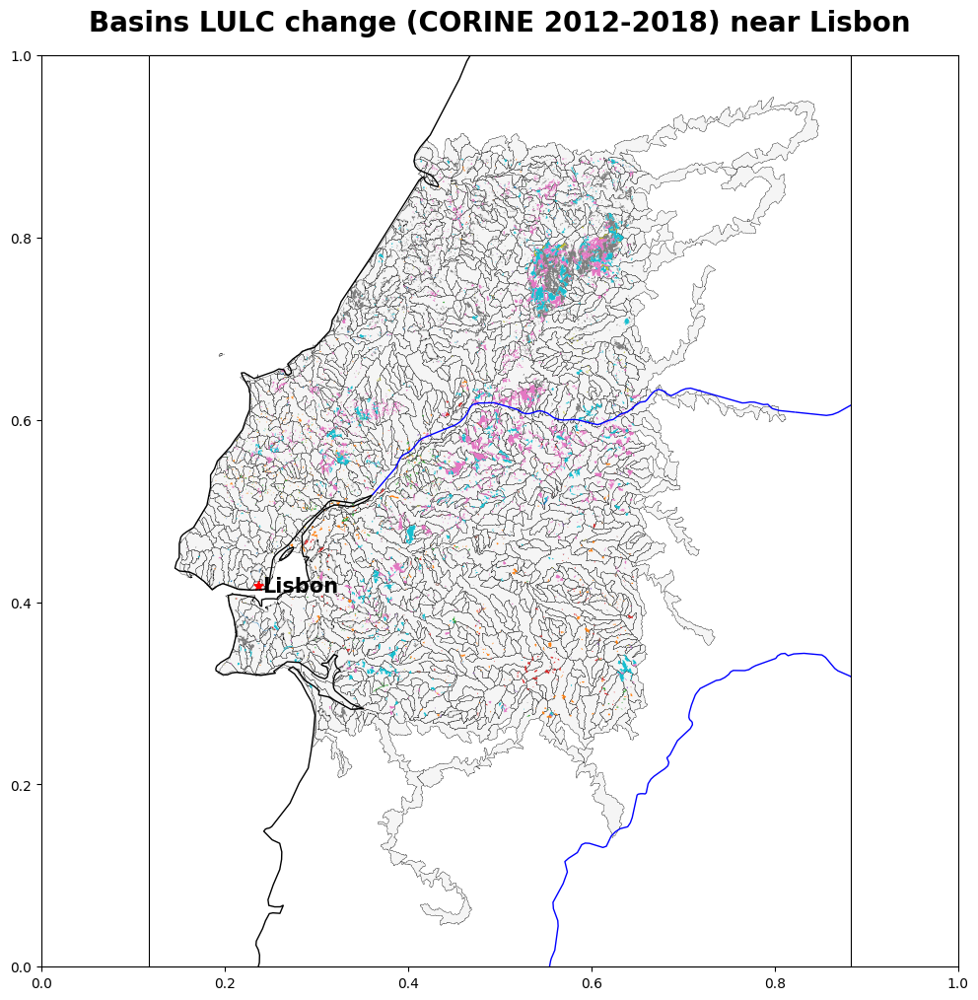

In [31]:

# Load the coastline and river data using Cartopy
coastlines = cfeature.COASTLINE.with_scale('10m')
rivers = cfeature.RIVERS.with_scale('10m')

# Plot using matplotlib and GeoPandas
fig, ax = plt.subplots(figsize=(12, 12))
ax.set_title('Basins LULC change (CORINE 2012-2018) near Lisbon', pad=18, fontsize=20, fontweight='semibold')
# Add coastline and river networks using Cartopy
ax = plt.axes(projection=ccrs.epsg(3035))
ax.add_feature(coastlines, linewidth=1, edgecolor='black')
ax.add_feature(rivers, linewidth=1, edgecolor='blue')
# Make the GeoPandas plot
# Filter the GeoPackage based on the bounding box - 0s
tajo_basins_gdf.cx[bbox_nearLisbon [0]:bbox_nearLisbon [2], bbox_nearLisbon [1]:bbox_nearLisbon [3]].plot(ax=ax, color='whitesmoke', edgecolor='black', linewidth=0.2)
# Plot land cover change areas
CLC_CHA_12_18_gdf.cx[bbox_nearLisbon [0]:bbox_nearLisbon [2], bbox_nearLisbon [1]:bbox_nearLisbon [3]].plot(ax=ax, column="Change")
# Plot Lisbon location
lisbon_gdf.plot(ax=ax,color='red', marker='*', markersize=50)
# Annotate the point with the city name
plt.annotate('Lisbon', xy=(lisbon_gdf.geometry.x.iloc[0], lisbon_gdf.geometry.y.iloc[0]), xytext=(3, -5),
             textcoords='offset points', ha='left', fontsize=15, weight='semibold', color='black');


The purpose of the above map is to visualise where and in what proportion (with respect to the basins) LULC change has occurred. Further details of changes in some areas will be discussed and analysed in more detail later.

> In some cases, LULC changes may occupy most of the basin area. Conversely, in other cases the area where LULC change has occurred is small compared to the basin area.

> The large patch northeast of Lisbon corresponds to the [Pedrógão Grande fires in the summer of 2017](https://earth.esa.int/web/earth-watching/image-of-the-week/content/-/article/fires-in-portugal/index.html).

## Reshape maps to Iberian Peninsula

### Join EU-Hydro datasets

We will obtain a dataset for the whole Iberian peninsula from the five EU-Hydro datasets.

Load the remaining datasets with GeoPandas (i.e. Ebro, Guadalquivir, Jucar and Duero).

In [32]:
# Read files using GeoPandas
# Tajo
duero_basins_gdf = gpd.read_file('/content/temp/EU_HYDRO/euhydro_duero_v012_GPKG/drainage_network_duero_public_beta_v009.gpkg', layer='duero_eudem2_basins', engine= 'pyogrio', use_arrow=True)
# Ebro
ebro_basins_gdf = gpd.read_file('/content/temp/EU_HYDRO/euhydro_ebro_v012_GPKG/drainage_network_ebro_public_beta_v009.gpkg', layer='ebro_eudem2_basins', engine= 'pyogrio', use_arrow=True)
# Guadalquivir
guadalquivir_basins_gdf = gpd.read_file('/content/temp/EU_HYDRO/euhydro_guadalquivir_v012_GPKG/drainage_network_guadalquivir_public_beta_v009.gpkg', layer='guadalquivir_eudem2_basins', engine= 'pyogrio', use_arrow=True)
# Jucar
jucar_basins_gdf = gpd.read_file('/content/temp/EU_HYDRO/euhydro_jucar_v012_GPKG/drainage_network_jucar_public_beta_v009.gpkg', layer='jucar_eudem2_basins', engine= 'pyogrio', use_arrow=True)


✅ Verify that the geometries are valid and that all basins are assigned to the major basin zone.

> A function is defined to check the validity of the geometries and that the namebasin column has all values filled.

In [33]:
def valid_mbz(mbz_gdf):
  nan_count = mbz_gdf['namebasin'].isna().sum()

  # Count None values (if the column contains Python None values)
  none_count = mbz_gdf['namebasin'].isnull().sum()

  # Total count of NaN and None values
  total_missing = nan_count + none_count
  print(mbz_gdf['namebasin'].iloc[0])
  if total_missing == 0:
    print('namebasin column ok')
  else:
    print("NaN count in namebasin:", nan_count)
    print("None count in namebasin:", none_count)
  # Check if any geometries are invalid
  any_invalid = not mbz_gdf.geometry.is_valid.all()
  if any_invalid:
      print("Some geometries are invalid.")
  else:
      print("All geometries are valid.")

Call the function for each GeoDataFrame

In [34]:
valid_mbz(duero_basins_gdf)
valid_mbz(ebro_basins_gdf)
valid_mbz(jucar_basins_gdf)
valid_mbz(guadalquivir_basins_gdf)
valid_mbz(tajo_basins_gdf)

Duero
namebasin column ok
All geometries are valid.
ebro
namebasin column ok
All geometries are valid.
Jucar
namebasin column ok
All geometries are valid.
Guadalquivir
NaN count in namebasin: 1
None count in namebasin: 1
All geometries are valid.
Tajo
namebasin column ok
All geometries are valid.


Assign the mbz name where it is not assigned.

In [35]:
# Fill None values in the NAMEBASIN COLUMN
guadalquivir_basins_gdf['namebasin'] = guadalquivir_basins_gdf['namebasin'].fillna('Guadalquivir', inplace=False)
# Check using the validation function
valid_mbz(guadalquivir_basins_gdf)

Guadalquivir
namebasin column ok
All geometries are valid.


>>> It's OK!!!



Now, we will merge the tabular information from the different datasets into a single GeoDataFrame using __Pandas__.

In [36]:
import pandas as pd
# Merge Duero and Ebro basins data in a Iberian Peninsula GeoDataFrame
iberia_basins_gdf = pd.concat([duero_basins_gdf, ebro_basins_gdf])
# Add Guadalquivir basins data to the Iberian Peninsula GeoDataFrame
iberia_basins_gdf = pd.concat([iberia_basins_gdf, guadalquivir_basins_gdf])
# Add Jucar basins data to the Iberian Peninsula GeoDataFrame
iberia_basins_gdf = pd.concat([iberia_basins_gdf, jucar_basins_gdf])
# Add Tajo basins data to the Iberian Peninsula GeoDataFrame
iberia_basins_gdf = pd.concat([iberia_basins_gdf, tajo_basins_gdf])

### Let's do a quick check of results

Now, we have a GeoDataFrame with the data of the five major basin zones, it should be fine. But, let's let's check a few things and adjust some details.

In [37]:
# Show the GeoDataFrame
iberia_basins_gdf

,h1_id,namebasin,h3_id,h4_id,h5_id,h6_id,h2_id,h7_id,PFAFSTETER,geometry
0,EU1H100202,Duero,None,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3041514.215 2046385.631, 30415..."
1,EU1H100202,Duero,EU1H304850,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3039417.333 2050713.770, 30392..."
2,EU1H100202,Duero,EU1H304823,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3034229.386 2051841.755, 30341..."
3,EU1H100202,Duero,EU1H304711,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3032153.334 2053840.916, 30321..."
4,EU1H100202,Duero,EU1H304711,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3032333.043 2056051.897, 30323..."
...,...,...,...,...,...,...,...,...,...,...
7718,EU1H100348,Tajo,EU1H304705,None,None,None,EU1H202764,None,None,"MULTIPOLYGON (((3126925.000 2059200.000, 31268..."
7719,EU1H100348,Tajo,EU1H305816,None,None,None,EU1H202422,None,None,"MULTIPOLYGON (((3187500.000 2003800.000, 31873..."
7720,EU1H100566,Tajo,None,None,None,None,None,None,None,"MULTIPOLYGON (((2777857.484 1746905.528, 27778..."
7721,EU1H100566,Tajo,None,None,None,None,None,None,None,"MULTIPOLYGON (((2777816.561 1746929.801, 27778..."


Create an ID for each basin.

> In addition, the name of the basin will be changed from 'ebro' to 'Ebro' with initial capital letter in the 'namebasin' column.

In [38]:
# Replace 'ebro' with 'Ebro' in the 'namebasin' column
iberia_basins_gdf['namebasin'] = iberia_basins_gdf['namebasin'].replace('ebro', 'Ebro')
# Create the new ID column
iberia_basins_gdf['Basin_ID'] = iberia_basins_gdf['namebasin'].str[:4] + (iberia_basins_gdf.index + 100000).astype(str)
iberia_basins_gdf

,h1_id,namebasin,h3_id,h4_id,h5_id,h6_id,h2_id,h7_id,PFAFSTETER,geometry,Basin_ID
0,EU1H100202,Duero,None,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3041514.215 2046385.631, 30415...",Duer100000
1,EU1H100202,Duero,EU1H304850,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3039417.333 2050713.770, 30392...",Duer100001
2,EU1H100202,Duero,EU1H304823,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3034229.386 2051841.755, 30341...",Duer100002
3,EU1H100202,Duero,EU1H304711,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3032153.334 2053840.916, 30321...",Duer100003
4,EU1H100202,Duero,EU1H304711,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3032333.043 2056051.897, 30323...",Duer100004
...,...,...,...,...,...,...,...,...,...,...,...
7718,EU1H100348,Tajo,EU1H304705,None,None,None,EU1H202764,None,None,"MULTIPOLYGON (((3126925.000 2059200.000, 31268...",Tajo107718
7719,EU1H100348,Tajo,EU1H305816,None,None,None,EU1H202422,None,None,"MULTIPOLYGON (((3187500.000 2003800.000, 31873...",Tajo107719
7720,EU1H100566,Tajo,None,None,None,None,None,None,None,"MULTIPOLYGON (((2777857.484 1746905.528, 27778...",Tajo107720
7721,EU1H100566,Tajo,None,None,None,None,None,None,None,"MULTIPOLYGON (((2777816.561 1746929.801, 27778...",Tajo107721


A great utility of Geopandas is that you can perform operations directly on the geometry of each _shapely_ object in the GeoDataFrame. This allows you to quickly estimate the area of each basin in the units of the projection (__metres__ for _ETRS89-extended / LAEA Europe - EPSG: 3035_).

In [39]:
# Estimate the area for each subbasind and add a column with this data to the GeoDataFrame
iberia_basins_gdf['Basins_Area_km2'] = iberia_basins_gdf.geometry.area / 1000000
# Show the GeoDatFrame
iberia_basins_gdf

,h1_id,namebasin,h3_id,h4_id,h5_id,h6_id,h2_id,h7_id,PFAFSTETER,geometry,Basin_ID,Basins_Area_km2
0,EU1H100202,Duero,None,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3041514.215 2046385.631, 30415...",Duer100000,0.101305
1,EU1H100202,Duero,EU1H304850,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3039417.333 2050713.770, 30392...",Duer100001,0.107661
2,EU1H100202,Duero,EU1H304823,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3034229.386 2051841.755, 30341...",Duer100002,0.100574
3,EU1H100202,Duero,EU1H304711,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3032153.334 2053840.916, 30321...",Duer100003,0.229556
4,EU1H100202,Duero,EU1H304711,None,None,None,EU1H201753,None,None,"MULTIPOLYGON (((3032333.043 2056051.897, 30323...",Duer100004,0.191780
...,...,...,...,...,...,...,...,...,...,...,...,...
7718,EU1H100348,Tajo,EU1H304705,None,None,None,EU1H202764,None,None,"MULTIPOLYGON (((3126925.000 2059200.000, 31268...",Tajo107718,114.325069
7719,EU1H100348,Tajo,EU1H305816,None,None,None,EU1H202422,None,None,"MULTIPOLYGON (((3187500.000 2003800.000, 31873...",Tajo107719,48.230485
7720,EU1H100566,Tajo,None,None,None,None,None,None,None,"MULTIPOLYGON (((2777857.484 1746905.528, 27778...",Tajo107720,10.489152
7721,EU1H100566,Tajo,None,None,None,None,None,None,None,"MULTIPOLYGON (((2777816.561 1746929.801, 27778...",Tajo107721,541.152549


✅ Use the built-in pandas methods _.info()_ and _.describe()_  to explore and check the data.
> These methods are often used in exploratory data analysis (EDA) when you start to explore the data; especially, if we are dealing with data we have never seen before.

The _.info()_ method prints information about a DataFrame including the index dtype and columns, non-null values and memory usage. So, for example, we can check  that all entries for `namebasin`, `geometry`, `Basin_id` and `Basins_Area_km2` are full.

In [40]:
iberia_basins_gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 27187 entries, 0 to 7722
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   h1_id            27184 non-null  object  
 1   namebasin        27187 non-null  object  
 2   h3_id            20514 non-null  object  
 3   h4_id            11638 non-null  object  
 4   h5_id            4402 non-null   object  
 5   h6_id            1100 non-null   object  
 6   h2_id            25182 non-null  object  
 7   h7_id            178 non-null    object  
 8   PFAFSTETER       0 non-null      object  
 9   geometry         27187 non-null  geometry
 10  Basin_ID         27187 non-null  object  
 11  Basins_Area_km2  27187 non-null  float64 
dtypes: float64(1), geometry(1), object(10)
memory usage: 3.7+ MB


While _.describe()_ method prints some statistical information about the the numeric type data.


In [41]:
iberia_basins_gdf.describe()

,Basins_Area_km2
count,2.718700e+04
mean,2.162657e+01
std,3.860381e+01
min,1.913480e-08
25%,7.804778e+00
50%,1.211895e+01
75%,2.191698e+01
max,1.693341e+03


> In this case only 'Basin_Area_km2` has been shown because it is the only numerical feature.

✅ Check if the area of all basins is close to the area of the Iberian Peninsula.
Sum the area of each basin.

In [42]:
# Sum each value of the column
print('The combined area of the basins is', iberia_basins_gdf['Basins_Area_km2'].sum().round(0), 'km2')

The combined area of the basins is 587962.0 km2


> The area of the Iberian Peninsula is almost $600$ $000$ ${km}^2$, some sources (of course we are talking about _Wikipedia_) approximate it to $583$ $254$ ${km}^2$ (Being serious this info can be found in a study of [Lorenzo-Lacruz _et al._](https://hess.copernicus.org/articles/15/2581/2011/)).
>> The above-mentioned extension of the Iberian Peninsula excludes the Balearic Islands, whose surface area is approximately $5$ $000$ ${km}^2$.

It's also possible to know the area of each major basin zone and its proportion within the Iberian Peninsula area.


In [43]:
# Major basin zones area
print_var = iberia_basins_gdf.groupby('namebasin')['Basins_Area_km2'].sum()
print('The surface area of each major basin zone (km2) is: \n', print_var.round(1), '\n')
# Major basin zones %
print_var = iberia_basins_gdf.groupby('namebasin')['Basins_Area_km2'].sum() / iberia_basins_gdf['Basins_Area_km2'].sum() * 100
print('The percentage of the surface area of the Iberian Peninsula covered by each major basin zone is: \n', print_var.round(1) )

The surface area of each major basin zone (km2) is: 
 namebasin
Duero           151511.5
Ebro            113136.3
Guadalquivir     86235.3
Jucar            61528.0
Tajo            175550.4
Name: Basins_Area_km2, dtype: float64 

The percentage of the surface area of the Iberian Peninsula covered by each major basin zone is: 
 namebasin
Duero           25.8
Ebro            19.2
Guadalquivir    14.7
Jucar           10.5
Tajo            29.9
Name: Basins_Area_km2, dtype: float64


>>> The zone of influence of the Tagus basin is the largest with $175$ $550$ $km^2$, covering approximately $30$ % of the Iberian Peninsula, while the zone of influence of the Júcar basin covers only $10$ % of the Iberian Peninsula with $61$ $528$ $km^2$.

Finally, visualise the results

<GeoAxes: >

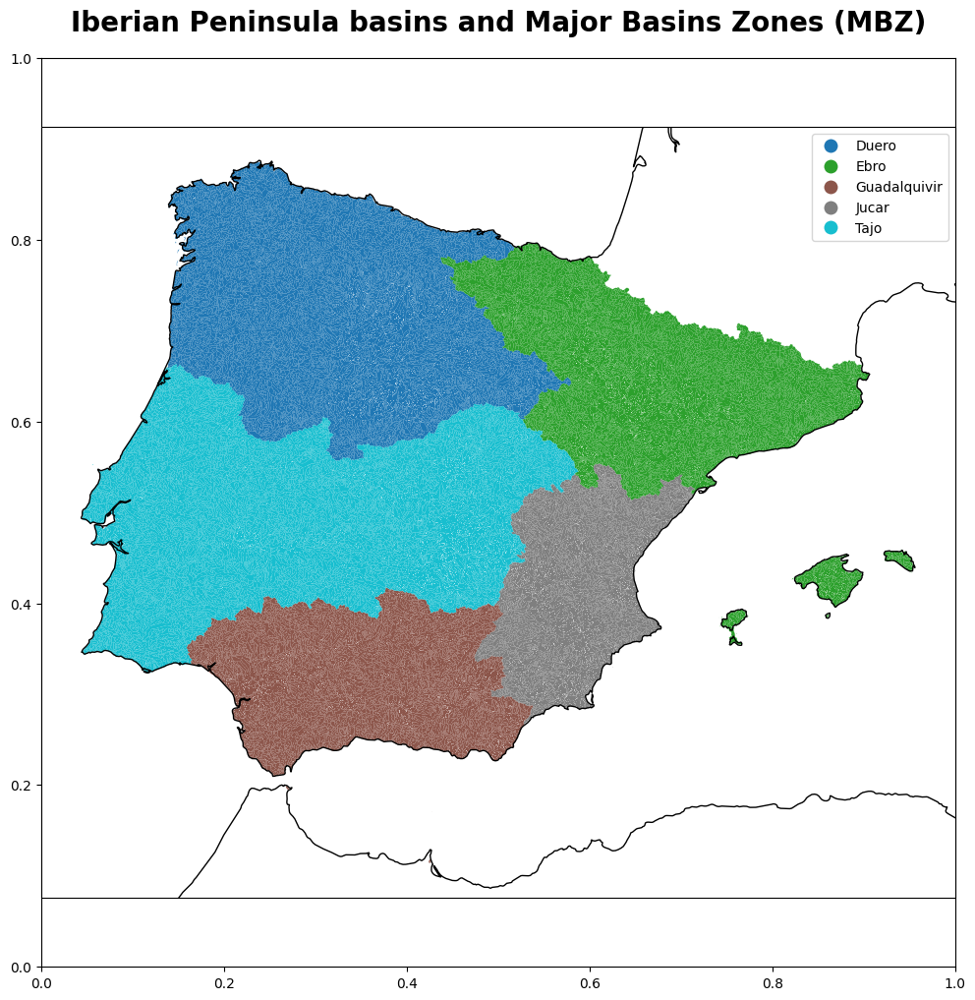

In [44]:
# Plot using matplotlib and GeoPandas - 20 s
fig, ax = plt.subplots(figsize=(12, 12))
ax.set_title('Iberian Peninsula basins and Major Basins Zones (MBZ)', pad=20, fontsize=20, fontweight='semibold')

# Add the coastal border lines as a background map using Cartopy
ax = plt.axes(projection=ccrs.epsg(3035))
ax.add_feature(coastlines, linewidth=1)


# Make the GeoPandas plot
iberia_basins_gdf.plot(ax=ax, column="namebasin", legend=True, legend_kwds={"loc":"upper right"})

### Clip the CORINE Land Cover change map to the Iberian Peninsula extent

Since the CORINE Land Cover change dataset cover an immense area, it is necessary to cut them down to the size of the Iberian Peninsula in order to speed up the operations to be carried out on this dataset.

In [45]:
# Get the bounding box (extent) of the mask GeoDataFrame - 0s
bbox_iberia = iberia_basins_gdf.total_bounds
bbox_iberia

array([2637332.4835, 1457100.    , 3832206.2223, 2464925.    ])

These are the bounding coordinates of the dataset. They limit an area known as the _bounding box_.

In [46]:
# Filter the GeoPackage based on the bounding box - 0s
CLC_CHA_12_18_gdf = CLC_CHA_12_18_gdf.cx[bbox_iberia[0]:bbox_iberia[2], bbox_iberia[1]:bbox_iberia[3]]

Visualise the dataset by plotting using __Matplotlib__

<Axes: title={'center': 'CORINE Land Cover Change Locations (2012-2018) in the Iberian Peninsula'}>

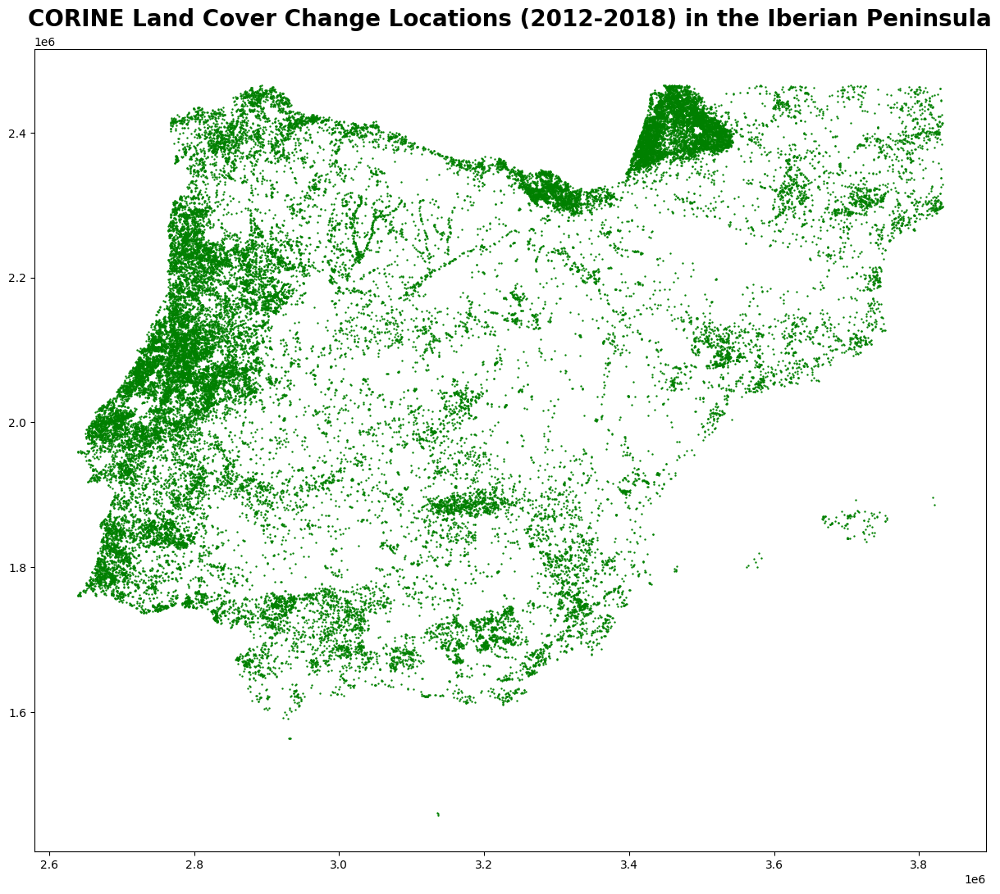

In [47]:
import matplotlib.pyplot as plt
# Plot using matplotlib and Geopandas
fig, ax = plt.subplots(figsize=(12, 12), layout='constrained')
ax.set_title('CORINE Land Cover Change Locations (2012-2018) in the Iberian Peninsula', pad=20, fontsize = 20, fontweight='semibold');
# Make the GeoPandas plot
# Plot centroids
CLC_CHA_12_18_gdf.centroid.plot(ax=ax, color='green', markersize=0.5)

### Intersect maps

We will intersect the basins map of the Iberian Peninsula with the CORINE Land Cover change map.

> The [Geopandas overlay method](https://geopandas.org/en/stable/docs/reference/api/geopandas.GeoDataFrame.overlay.html) will be used for this operation.
>The intersection of two GeoDataFrames is not "commutative". Since, if the positions of the GeoDataFrames are interchanged, the order of the resulting GeoDataFrame columns changes and the process is more time-consuming.
>> __Note from Geopandas developers:__ "Every operation in GeoPandas is planar, i.e. the potential third dimension is not taken into account".

Try overlapping __CLC_CHA_12_18_gdf__ with __iberia_basins_gdf__.

In [48]:
# Intersect the GeoDataFrames
Iberia_CLC_CHA1218 = CLC_CHA_12_18_gdf.overlay(iberia_basins_gdf, how='intersection', keep_geom_type=True, make_valid=True) #- 59s

Try overlapping __iberia_basins_gdf__ with __CLC_CHA_12_18_gdf__.

In [49]:
# Intersect the GeoDataFrames
Iberia_CLC_CHA1218 = iberia_basins_gdf.overlay(CLC_CHA_12_18_gdf, how='intersection', keep_geom_type=True, make_valid=True) #- 29s

> This is less time-consuming.
>> __Note from Geopandas developers:__ "_Overlays method_ operate at the DataFrame level, not on individual geometries, and the properties from both are retained. In effect, for every shape in the left GeoDataFrame, this operation is executed against every other shape in the right GeoDataFrame".

In [50]:
# Show the resulted GeoDataFrame
Iberia_CLC_CHA1218

,h1_id,namebasin,h3_id,h4_id,h5_id,h6_id,h2_id,h7_id,PFAFSTETER,Basin_ID,Basins_Area_km2,Change,ID,Code_12,Code_18,Chtype,Remark,Area_Ha,geometry
0,EU1H100202,Duero,None,None,None,None,EU1H201753,None,None,Duer100000,0.101305,323-231,EU-298923,323,231,R,None,14.778336,"POLYGON ((3041529.679 2046579.183, 3041498.750..."
1,EU1H100202,Duero,EU1H304850,None,None,None,EU1H201753,None,None,Duer102377,16.764203,323-231,EU-298923,323,231,R,None,14.778336,"POLYGON ((3041525.000 2046650.000, 3041521.179..."
2,EU1H100348,Tajo,EU1H304842,None,None,None,EU1H202800,None,None,Tajo104840,24.940590,323-231,EU-298923,323,231,R,None,14.778336,"POLYGON ((3041575.000 2046700.000, 3041575.000..."
3,EU1H100348,Tajo,EU1H304842,EU1H404209,None,None,EU1H202800,None,None,Tajo106006,23.580960,323-231,EU-298923,323,231,R,None,14.778336,"MULTIPOLYGON (((3041575.000 2046650.000, 30416..."
4,EU1H100202,Duero,EU1H304711,None,None,None,EU1H201753,None,None,Duer100003,0.229556,323-324,EU-299557,323,324,R,None,51.563018,"POLYGON ((3032675.000 2053075.000, 3032650.000..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52889,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107721,541.152549,324-312,EU-315952,324,312,R,None,11.623067,"POLYGON ((2769667.730 1808820.280, 2769702.240..."
52890,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107721,541.152549,334-324,EU-385453,334,324,R,None,44.924097,"POLYGON ((2788942.550 1855442.900, 2789015.030..."
52891,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107722,125.697400,211-222,EU-26172,211,222,R,None,9.283691,"POLYGON ((2828149.430 1909568.130, 2828147.680..."
52892,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107722,125.697400,222-211,EU-42835,222,211,R,None,10.907737,"POLYGON ((2829355.780 1909567.600, 2829346.640..."


<Axes: >

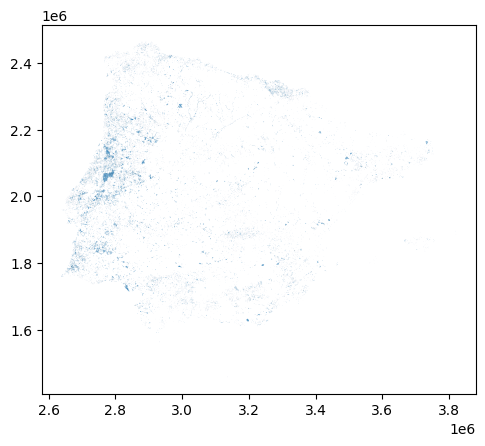

In [51]:
# Plot to visualize
Iberia_CLC_CHA1218.plot()

## Save and share the data

### Make a connection with Drive

Using the Google colab library we make a conection to our Drive.
> This way, we can access to all folders and files that are avilable in our Drive.

In [52]:
from google.colab import drive
# Mount Drive
drive.mount('/content/drive')

Mounted at /content/drive


Now, you can explore your Drive from your Colab Notebook.
> Click on the folder icon in the left side of your screen (_click on the refresh icon if you can't see the drive folder_).

### Organise your project in Drive

Organise your project in Drive.

We will create a folder called __Iberia_project__.

Organised as follows:
- Iberia_project
  -   01_Data
  -   02_Notebooks
  -   03_Results
  -   04_Doc

Now, we will save the results of this notebook in the subfolder __03_Results__.

In [53]:
import os
from os import path

drive_path = "/content/drive/MyDrive/"
folder_names = ["Iberia_project", "Iberia_project/01_Data", "Iberia_project/02_Notebooks", "Iberia_project/03_Results", "Iberia_project/04_Doc"]

for folder_name in folder_names:
  folder_path = drive_path + folder_name
  if path.exists(folder_path) == False:
    os.mkdir(folder_path)
    print(folder_path, 'directory has been created')

/content/drive/MyDrive/Iberia_project directory has been created
/content/drive/MyDrive/Iberia_project/01_Data directory has been created
/content/drive/MyDrive/Iberia_project/02_Notebooks directory has been created
/content/drive/MyDrive/Iberia_project/03_Results directory has been created
/content/drive/MyDrive/Iberia_project/04_Doc directory has been created


### Save the Iberia Basins GeoDataFrame to a Geopackage in __Drive__

Saving a geodataframe as a geopackage or [any of the output formats that geopandas allows](https://geopandas.org/en/stable/docs/reference/io.html) is simple enough to take up only a single line of code.

> Some output file formats supported by geopandas are:
- ESRI shapefile; `.shp`.
- Geographic JavaScript Object Notation (GeoJSON); `.geojson`.
- OGC GeoPackage; `.gpkg`.
-  _This list is not exhaustive_.

> It is also possible to save the GeoDataFrame data not as a file but directly into a [PostGIS database](https://postgis.net/) (not shown in this notebook).




In [54]:
# Save the GeoDataFrames to a Geopackage using the pyogrio engine
iberia_basins_gdf.to_file('/content/drive/MyDrive/Iberia_project/03_Results/Iberia_Basins.gpkg', driver='GPKG', layer='subbasins', engine= 'pyogrio')

> The geopackage has been saved in __Drive__

### Save the intersected GeoDataFrame to a Geopackage in the __Colab machine__


Also, you can save the default files in the Colab virtual machine.

> In this case we save to the Colab virtual machine as a backup (checkpoint), since we will continue modifying this geodataframe, and we will save only in Drive when we have the definitive geodataframe.

In [55]:
# Save the GeoDataFrame to a Geopackage using the pyogrio engine
Iberia_CLC_CHA1218.to_file('Iberia_CLC_CHA_2012_2018.gpkg', driver='GPKG', layer='subbasins_change', engine= 'pyogrio')

The file has been saved in the default folder of the Colab virtual machine. _Remember that we are not working on our PC_.

> The default folder is `/content`, if we want to save in another folder inside the Colab virtual machine, we only need to specify the path and filename.

```python
# Save the GeoDataFrame to a Geopackage using the pyogrio engine
Iberia_CLC_CHA1218.to_file('/content/temp/CLC/Iberia_CLC_CHA_2012_2018.gpkg', driver='GPKG', layer='subbasins_change', engine= 'pyogrio')

### This code is in a text cell  ###
```


>>> In case you need to retrieve the file from the Colab virtual machine you can use the following code:


```python
# Read files using GeoPandas
Iberia_CLC_CHA1218 =  gpd.read_file('/content/Iberia_CLC_CHA_2012_2018.gpkg', layer='subbasins_change', engine= 'pyogrio', use_arrow=True)

### This code is in a text cell  ###
```


### Download files to __your machine__ (_Non-executable_)


There are to ways to download files to your machine:
- Using code.
- Using the side panel.

__Using code:__ To download files within your notebook's code workflow you must import the Google colab files module and then use the _download_ method.

It is easier to understand at the code below.

```python
from google.colab import files
# Download the file
files.download('/content/Iberia_CLC_CHA_2012_2018.gpkg')

### This code is in a text cell  ###
```
__Using the side panel:__
1. Click on the folder icon in the side panel.
2. Locate the file in the _content_ directory.
3. Click on the three vertical dots at the end of the file name.
4. Click download.

> My personal opinion is that it is better to store the files in Drive, if you need to save them for future use. And only download them when necessary.

## Import remaining CORINE Land cover change data



We have proposed categories to classify different types of land use and land cover change for the 44 thematic classes of the [CORINE programme](https://land.copernicus.eu/en/products/corine-land-cover). The defined categories of change group different land cover classes around a sub-group of interest, but also take into account their hydrological characteristics (expected water retention level).

> The sub-groups of interest defined were based on levels 1 and 2 of the Copernicus classes and those defined for [Copernicus Global Land Service: Land Cover 100m: Collection 3](https://lcviewer.vito.be/about).

> It should be noted that the discretisation of cover changes for the classes where anthropogenic intervention is more intense (Artificial surfaces and agricultural areas) were defined in more detail.

> When working with tabular data (Spreadsheets or databases), we can use [Pandas](https://pandas.pydata.org/docs/) to explore, clean and process the data.

### Download some tables from the course's Drive folder

In the [course's Drive folder](https://drive.google.com/drive/folders/1Nw_fVfO3BkgbOnq3llvp6QAqoOr2SfEr?usp=sharing) we have uploaded the necessary files for the course.Download the files using the share links copied from Drive with the [gdown](https://github.com/wkentaro/gdown) library.
>
> Using the gdown library, we can skip the security notice allowing you to download large files (curl/wget fails) and
recursively download files in a folder (maximum 50 files per folder).

> This way of sharing and working with data stored in Drive can be replicated with your teammates.

> Sometimes we may wait up to 24h (after upload and change the access to the file) when we are sharing it with anyone with a sharing link.

In [59]:
import gdown # gdown is a library already installed by default in the Colab environment.

file_name = 'Change_processes.xlsx'
url='https://docs.google.com/spreadsheets/d/1ASa8voa2EZtzb89rDauno4Je7UETS4LC/edit?usp=sharing&ouid=104306561824878578709&rtpof=true&sd=true' # Paste here the share link copied from Drive
gdown.download(url=url, output=file_name  ,quiet=False, fuzzy=True) # you can copy-and-paste a URL from Google Drive with fuzzy=True


Downloading...
From: https://drive.google.com/uc?id=1ASa8voa2EZtzb89rDauno4Je7UETS4LC
To: /content/Change_processes.xlsx
100%|██████████| 131k/131k [00:00<00:00, 50.5MB/s]


'Change_processes.xlsx'

### Read the Land Use and Land Cover (LULC) change processes Excel file

The change processes considered in this study can be read in the spreadsheet _Change_CODs_.

> Pandas can read various files from _comma-separated values_ (.csv files) to STATA files. In this case we work with an Excel Workbook because many different users are familiar with this type of files.

In [60]:
import pandas as pd

# Read the data using Pandas
change_names =pd.read_excel('/content/Change_processes.xlsx', sheet_name='Change_CODs', header=0, index_col= None)
# Show the DataFrame
change_names

,Before_change,After_change,Code,Change_process_full_name,Color_plotly
0,Any,Same,999,Not considered change,"rgb(153,153,153)"
1,Urban (Not densely built-up areas),Urban (Densely built-up areas),1001,Built-up densification,"rgb(228,26,28)"
2,Urban (Densely built-up areas),Urban (Not densely built-up areas),1002,Reduction of built-up density.,"rgb(228,26,28)"
3,Urban (Densely built-up areas),Urban (Green),1003,Green urbanization (from Densely built-up areas),"rgb(228,26,28)"
4,Urban (Not densely built-up areas),Urban (Green),1004,Green urbanization (from Not densely built-up ...,"rgb(228,26,28)"
...,...,...,...,...,...
86,Water,Other vegetation,9400,Water reduction & Vegetated area expansion,#FF97FF
87,Water,Bare,9500,Water reduction & Bare area expansion,#FF97FF
88,Water,Glacier,9600,Water reduction & Glacier expansion,#FF97FF
89,Water,Burnt,9700,Water reduction & Burnt area expansion,#FF97FF


Let's take a look at the information we have for the different CORINE thematic classes in the spreadsheet _Corine_classes_.

>If a file is located directly in the `/content` folder of the Colab virtual machine, we can access it only by specifying the filename.

> Colab has a couple of utilities for dataframes:  One for converting dataframes into interactive tables and one for suggesting charts.
>> Try the _Suggest charts_ functionality. Look for the _bars_ icon in the rigth upper corner and click on it.


In [61]:
# Read the data using Pandas
corine_classes = pd.read_excel('Change_processes.xlsx', sheet_name='Corine_classes', header=0, index_col= None) ### Use the filename
# Show the DataFrame
corine_classes

,Code_level_1,Name_level_1,Code_level_2,Name_level_2,Code_level_3,Name_level_3,Slope_(%),CN_A,CN_B,CN_C,CN_D,Po_A_[mm],Po_B_[mm],Po_C_[mm],Po_D_[mm],Water retention level,Group_for_change_processes_identification,Subgroup_for_change_processes_identification
0,1,Artificial surfaces,11,Urban fabric,111,Continuos urban fabric,NaN,98,98,98,98,1,1,1,1,Very Low,Urban,Urban (Densely built-up areas)
1,1,Artificial surfaces,12,Urban fabric,112,Discontinuous urban fabric,NaN,68,78,86,89,24,14,8,6,Low,Urban,Urban (Not densely built-up areas)
2,1,Artificial surfaces,12,"Industrial, commercial and transport units",121,Industrial or commercial units,NaN,89,93,94,94,6,4,3,3,Very Low,Urban,Urban (Densely built-up areas)
3,1,Artificial surfaces,12,"Industrial, commercial and transport units",122,Road and rail networks and associated land,NaN,98,98,98,98,1,1,1,1,Very Low,Urban,Urban (Densely built-up areas)
4,1,Artificial surfaces,12,"Industrial, commercial and transport units",123,Port areas,NaN,98,98,98,98,1,1,1,1,Very Low,Urban,Urban (Densely built-up areas)
5,1,Artificial surfaces,12,"Industrial, commercial and transport units",124,Airports,NaN,68,78,86,89,24,14,8,6,Low,Urban,Urban (Not densely built-up areas)
6,1,Artificial surfaces,13,"Mine, dump and construction sites",131,Mineral extraction sites,NaN,76,85,89,91,16,9,6,5,Low,Urban,Urban (Not densely built-up areas)
7,1,Artificial surfaces,13,"Mine, dump and construction sites",132,Dumps sites,NaN,72,82,86,89,20,11,8,6,Low,Urban,Urban (Not densely built-up areas)
8,1,Artificial surfaces,13,"Mine, dump and construction sites",133,Construction sites,NaN,68,78,86,89,24,14,8,6,Low,Urban,Urban (Not densely built-up areas)
9,1,Artificial surfaces,14,"Artificial, non-agri-cultural vegetated areas",141,Green Urban areas,NaN,49,69,78,84,53,23,14,10,Medium-high,Urban,Urban (Green)


For example, it suggests a plot in which we can see how many of the 44 CORINE thematic classes belong to a CORINE land cover group (e.g. artificial surfaces, agricultural areas, water bodies, etc.).
> In the plot, we can identify that the broadest variety of CORINE thematic classes is found in the _agricultural areas group_ followed by the _forest and semi-natural areas group_.
>> Please note that the __CORINE land cover group__ is not necessarily the same as the __LULC group__ identified in this study for the analysis of change processes.

> In addition to the **matplotlib** library, the automatic visualisation options also make use of [seaborn](https://seaborn.pydata.org/). This is a library that leverages matplotlib to create particularly attractive and informative statistical graphs.

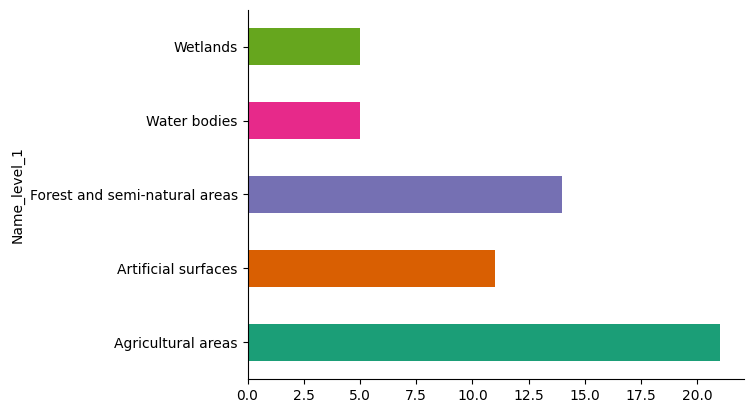

In [62]:
from matplotlib import pyplot as plt
import seaborn as sns
corine_classes.groupby('Name_level_1').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

it also suggests a plot in which we can see how many of the 44 CORINE thematic classes are ranked by its water retention level as _"Very High"_, _"High"_, etc.

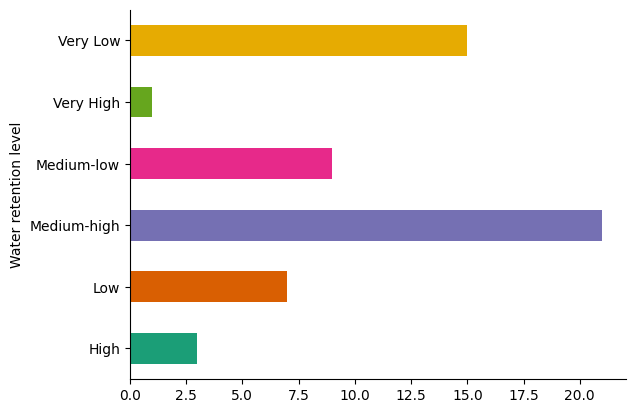

In [63]:
from matplotlib import pyplot as plt
import seaborn as sns
corine_classes.groupby('Water retention level').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

It identified that only one CORINE thematic class is considered to have a very high level of water retention. But, __which one?__

In [64]:
# Call for the rows where the Water retention leve is 'Very High'
corine_classes.loc[corine_classes['Water retention level'] =='Very High']

,Code_level_1,Name_level_1,Code_level_2,Name_level_2,Code_level_3,Name_level_3,Slope_(%),CN_A,CN_B,CN_C,CN_D,Po_A_[mm],Po_B_[mm],Po_C_[mm],Po_D_[mm],Water retention level,Group_for_change_processes_identification,Subgroup_for_change_processes_identification
47,4,Wetlands,41,Inland wetlands,412,Peat bogs,NaN,17,34,67,76,248,99,25,16,Very High,Wetland,Wetland (Peat bogs)


> __Answer:__ CORINE Land Cover class 412, Wetland (Peat bogs).

Although the automatic visualisation options are good, they can be improved in many cases. However, they are a helpful source of seed code that will speed up our work.

> Arrange the bar chart showing the highest retention levels at the top and the lowest at the bottom.

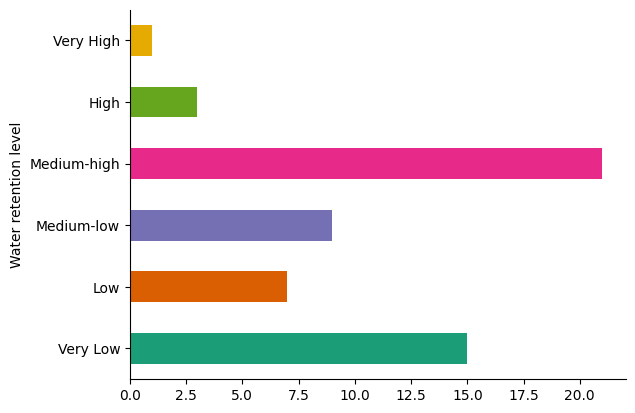

In [65]:
# We plot a copy in the desired order of the original series.
corine_classes.groupby('Water retention level').size().loc[['Very Low', 'Low', 'Medium-low', 'Medium-high', 'High', 'Very High']].plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

# Analysing the data

## Analyse LULC change in the basins of the Iberian Peninsula.

### Estimate the LULC change area for each basin.

Estimate and add columns with the LULC change area and the relative LULC change area in the __Iberia_CLC_CHA1218 GeoDataFrame__.

In [66]:
# Estimate the land cover change area [km2] and add a column with this data to the GeoDataFrame
Iberia_CLC_CHA1218['Change_area_km2'] = Iberia_CLC_CHA1218.geometry.area / 1000000
# Estimate the relative area [%] for each discrete LULC change and add a column with this data to the GeoDataFrame
Iberia_CLC_CHA1218['Relative_change_area_%']  = (Iberia_CLC_CHA1218['Change_area_km2'] / Iberia_CLC_CHA1218['Basins_Area_km2']) * 100
# Show the GeoDatFrame
Iberia_CLC_CHA1218

,h1_id,namebasin,h3_id,h4_id,h5_id,h6_id,h2_id,h7_id,PFAFSTETER,Basin_ID,...,Change,ID,Code_12,Code_18,Chtype,Remark,Area_Ha,geometry,Change_area_km2,Relative_change_area_%
0,EU1H100202,Duero,None,None,None,None,EU1H201753,None,None,Duer100000,...,323-231,EU-298923,323,231,R,None,14.778336,"POLYGON ((3041529.679 2046579.183, 3041498.750...",0.001609,1.588079
1,EU1H100202,Duero,EU1H304850,None,None,None,EU1H201753,None,None,Duer102377,...,323-231,EU-298923,323,231,R,None,14.778336,"POLYGON ((3041525.000 2046650.000, 3041521.179...",0.000013,0.000075
2,EU1H100348,Tajo,EU1H304842,None,None,None,EU1H202800,None,None,Tajo104840,...,323-231,EU-298923,323,231,R,None,14.778336,"POLYGON ((3041575.000 2046700.000, 3041575.000...",0.006216,0.024925
3,EU1H100348,Tajo,EU1H304842,EU1H404209,None,None,EU1H202800,None,None,Tajo106006,...,323-231,EU-298923,323,231,R,None,14.778336,"MULTIPOLYGON (((3041575.000 2046650.000, 30416...",0.139946,0.593468
4,EU1H100202,Duero,EU1H304711,None,None,None,EU1H201753,None,None,Duer100003,...,323-324,EU-299557,323,324,R,None,51.563018,"POLYGON ((3032675.000 2053075.000, 3032650.000...",0.090608,39.470803
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52889,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107721,...,324-312,EU-315952,324,312,R,None,11.623067,"POLYGON ((2769667.730 1808820.280, 2769702.240...",0.116231,0.021478
52890,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107721,...,334-324,EU-385453,334,324,R,None,44.924097,"POLYGON ((2788942.550 1855442.900, 2789015.030...",0.449241,0.083016
52891,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107722,...,211-222,EU-26172,211,222,R,None,9.283691,"POLYGON ((2828149.430 1909568.130, 2828147.680...",0.092837,0.073857
52892,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107722,...,222-211,EU-42835,222,211,R,None,10.907737,"POLYGON ((2829355.780 1909567.600, 2829346.640...",0.109077,0.086778


✅ Check results using _.info()_ method

In [67]:
Iberia_CLC_CHA1218.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 52894 entries, 0 to 52893
Data columns (total 21 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   h1_id                   52879 non-null  object  
 1   namebasin               52894 non-null  object  
 2   h3_id                   30361 non-null  object  
 3   h4_id                   13173 non-null  object  
 4   h5_id                   3651 non-null   object  
 5   h6_id                   734 non-null    object  
 6   h2_id                   46483 non-null  object  
 7   h7_id                   124 non-null    object  
 8   PFAFSTETER              0 non-null      object  
 9   Basin_ID                52894 non-null  object  
 10  Basins_Area_km2         52894 non-null  float64 
 11  Change                  52894 non-null  object  
 12  ID                      52894 non-null  object  
 13  Code_12                 52894 non-null  object  
 14  Code_18       

✅ Check that you have not created data for physically meaningless features.

In [68]:
# Check that the area of all basins is positive
print(Iberia_CLC_CHA1218.loc[Iberia_CLC_CHA1218['Basins_Area_km2'] <= 0])
# Check that the area of all LULC changes areas is positive
print(Iberia_CLC_CHA1218.loc[Iberia_CLC_CHA1218['Change_area_km2'] <= 0])

Empty GeoDataFrame
Columns: [h1_id, namebasin, h3_id, h4_id, h5_id, h6_id, h2_id, h7_id, PFAFSTETER, Basin_ID, Basins_Area_km2, Change, ID, Code_12, Code_18, Chtype, Remark, Area_Ha, geometry, Change_area_km2, Relative_change_area_%]
Index: []

[0 rows x 21 columns]
Empty GeoDataFrame
Columns: [h1_id, namebasin, h3_id, h4_id, h5_id, h6_id, h2_id, h7_id, PFAFSTETER, Basin_ID, Basins_Area_km2, Change, ID, Code_12, Code_18, Chtype, Remark, Area_Ha, geometry, Change_area_km2, Relative_change_area_%]
Index: []

[0 rows x 21 columns]


> It seems like everything is Ok.

### Make a quick analysis of the LULC change areas in the Iberian Peninsula.

A first approach is to determine the range of values and estimate some basic statistics such as mean and median basin area, LULC chnage area and the relation between these two variables in the Iberian Peninsula.

__Pandas/Geopandas__ has methods for grouping and estimating statistics that allow these calculations to be performed on thousands or millions of data in a single line of code and in seconds.

> _The following code may look a bit messy, but this is due to the desire to print the values in a certain way, rather than the code for the statistical calculations._



In [69]:
# Number of affected basins by LULC change
print('The number of affected basins by LULC change is:', len(Iberia_CLC_CHA1218.groupby('Basin_ID')), 'basins. \n')
# Max, min and mean area of the affected basins.
print('The maximum area of any affected basin is: ', '{:.4g}'.format(Iberia_CLC_CHA1218['Basins_Area_km2'].max()), 'km2,',
      'the minimun area is:' ,'{:.4g}'.format(Iberia_CLC_CHA1218['Basins_Area_km2'].min()), 'km2, \n',
      'the mean area is:', '{:.4g}'.format(Iberia_CLC_CHA1218.groupby('Basin_ID').mean(numeric_only=True)['Basins_Area_km2'].mean()), 'km2,',
      'and the median area is:', '{:.4g}'.format(Iberia_CLC_CHA1218.groupby('Basin_ID').mean(numeric_only=True)['Basins_Area_km2'].median()), 'km2. \n')
# Max, min and mean area of any discrete LULC change area.
print('The maximum area of any discrete LULC change area is:', '{:.4g}'.format(Iberia_CLC_CHA1218['Change_area_km2'].max()), 'km2,',
      'the minimun area is:', '{:.4g}'.format(Iberia_CLC_CHA1218['Change_area_km2'].min()), 'km2, \n',
      'the mean area is:','{:.4g}'.format(Iberia_CLC_CHA1218['Change_area_km2'].mean()), 'km2,',
      'and the median area is:','{:.4g}'.format(Iberia_CLC_CHA1218['Change_area_km2'].median()), 'km2. \n')
# Max, min and mean area of all types of LULC change in one basin.
print('The maximum area of all types of LULC change in one basin is:', '{:.4g}'.format(Iberia_CLC_CHA1218.groupby('Basin_ID').sum(numeric_only=True)['Change_area_km2'].max(numeric_only=True)), 'km2,',
      'the minimun area is:', '{:.4g}'.format(Iberia_CLC_CHA1218.groupby('Basin_ID').sum(numeric_only=True)['Change_area_km2'].min(numeric_only=True)), 'km2, \n',
      'the mean area is:', '{:.4g}'.format(Iberia_CLC_CHA1218.groupby('Basin_ID').sum(numeric_only=True)['Change_area_km2'].mean(numeric_only=True)), 'km2,',
      'and the median area is:', '{:.4g}'.format(Iberia_CLC_CHA1218.groupby('Basin_ID').sum(numeric_only=True)['Change_area_km2'].median(numeric_only=True)), 'km2. \n')

The number of affected basins by LULC change is: 10738 basins. 

The maximum area of any affected basin is:  1693 km2, the minimun area is: 0.0009988 km2, 
 the mean area is: 33.02 km2, and the median area is: 16.89 km2. 

The maximum area of any discrete LULC change area is: 20.33 km2, the minimun area is: 9.43e-11 km2, 
 the mean area is: 0.1901 km2, and the median area is: 0.08193 km2. 

The maximum area of all types of LULC change in one basin is: 103.2 km2, the minimun area is: 1.352e-07 km2, 
 the mean area is: 0.9362 km2, and the median area is: 0.292 km2. 



> Remeber that we also have the _.describe()_ method

In [70]:
Iberia_CLC_CHA1218.describe()

,Basins_Area_km2,Area_Ha,Change_area_km2,Relative_change_area_%
count,52894.000000,52894.000000,5.289400e+04,5.289400e+04
mean,85.986452,42.731053,1.900565e-01,8.424042e-01
std,164.031070,191.934246,4.789757e-01,2.684029e+00
min,0.000999,0.108407,9.430226e-11,8.357022e-11
25%,14.713891,7.222959,4.560351e-02,6.327517e-02
50%,31.624456,12.959270,8.192761e-02,2.345986e-01
75%,80.672220,29.449385,1.763119e-01,6.850715e-01
max,1693.341125,7965.154658,2.032738e+01,9.855201e+01


Now, a similar analysis will be carried out but by major basin zones. In this case, the [Plotly](https://plotly.com/python/) library will be used to generate box plots of each variable for each MBZ.  

> __Plotly__ allows to make interactive and informative graphs.

In [71]:
small2big = ['Jucar', 'Guadalquivir',  'Ebro', 'Duero', 'Tajo'] #MBZ names ordered by area
for mbz_name in small2big:
  # Number of affected basins by LULC change
  print('The number of affected basins by LULC change in', mbz_name , 'zone of influence is:', len(Iberia_CLC_CHA1218.loc[Iberia_CLC_CHA1218['namebasin']==mbz_name].groupby('Basin_ID')), 'basins. \n')

The number of affected basins by LULC change in Jucar zone of influence is: 839 basins. 

The number of affected basins by LULC change in Guadalquivir zone of influence is: 1662 basins. 

The number of affected basins by LULC change in Ebro zone of influence is: 1346 basins. 

The number of affected basins by LULC change in Duero zone of influence is: 3089 basins. 

The number of affected basins by LULC change in Tajo zone of influence is: 3802 basins. 



> Note that although the _Guadalquivir zone of influence_ is smaller than the _Ebro zone of influence_, it has more affected basins, contrary to the trend in the other basins.

In [72]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots


# Create subplots with different axes
fig = make_subplots(rows=1, cols=3, subplot_titles=('Basins Area (km^2)', 'Change Area (km^2)', 'Relative Change Area (%)'), horizontal_spacing=0.01, vertical_spacing=0.01, shared_yaxes=True)

small2big = ['Jucar', 'Guadalquivir',  'Ebro', 'Duero', 'Tajo']
COLORS = px.colors.qualitative.D3

for mbz_name, COLOR in zip(small2big,px.colors.qualitative.D3[:5]):
  # Add traces for each variable
  fig.add_trace(go.Box(x = Iberia_CLC_CHA1218['namebasin'].loc[Iberia_CLC_CHA1218['namebasin']==mbz_name], y=Iberia_CLC_CHA1218['Basins_Area_km2'].loc[Iberia_CLC_CHA1218['namebasin']==mbz_name ], name=mbz_name, line_color=COLOR, boxmean=True), row=1, col=1)
  fig.add_trace(go.Box(x = Iberia_CLC_CHA1218['namebasin'].loc[Iberia_CLC_CHA1218['namebasin']==mbz_name], y=Iberia_CLC_CHA1218['Change_area_km2'].loc[Iberia_CLC_CHA1218['namebasin']==mbz_name ], name=mbz_name,line_color=COLOR, boxmean=True), row=1, col=2)
  fig.add_trace(go.Box(x = Iberia_CLC_CHA1218['namebasin'].loc[Iberia_CLC_CHA1218['namebasin']==mbz_name], y=Iberia_CLC_CHA1218['Relative_change_area_%'].loc[Iberia_CLC_CHA1218['namebasin']==mbz_name ], name=mbz_name, line_color=COLOR, boxmean=True),  row=1, col=3)


# Set different y-axis limits for each subplot
fig.update_yaxes(exponentformat='power',type="log", range=[-12, 4])


# Update the layout to enhance the aesthetics
fig.update_layout(showlegend=False, height=900, margin=dict(l=50, r=50, t=50, b=50))


# Show plot
fig.show()

Some comments on this figure:

> The largest basin is in the zone of influence of the *Tagus river basin*. Nonetheless, the biggest discrete LULC change area is in the zone of influence of the *Duero river basin*.

> The dashed line represents the mean. It can be seen that the mean is generally above the third quartile, i.e. higher than $75$ % of the observed values, and in all cases above the median.

> The relative change area tends to be less than $1$ %. Nevertheless, most of the major basin zones have at least one basin with a relative LULC change area greater than $80$ %, except for the zone of influence of the *Ebro river basin*, which has no relative LULC change area greater than $45$ %.

> Approximately half of the discrete LULC change observed are between $5$ and $20$ hectares. _The Minimum Mapping Unit (MMU) for areal phenomena in CLC Change (CHA) layer is $5$ hectares (ha)._


>>> __Change area__ and __relative change area__ correspond for each __discrete LULC change area__, not for all LULC changes of the same type in the same basin, nor all LULC changes of any same type in the same basin. There may be several discrete areas of LULC change of the same and different types in the same basin.

Basin area and LULC change area are independent features, and relative change area is a dependent feature of the previous two. Let's look at the relationship between these three variables using a correlation matrix:
> For data analysis, the __seaborn__ library also offers a wide variety of graphs high-level interface for data visualization that can be very useful and interesting. Here is an example of one of them:

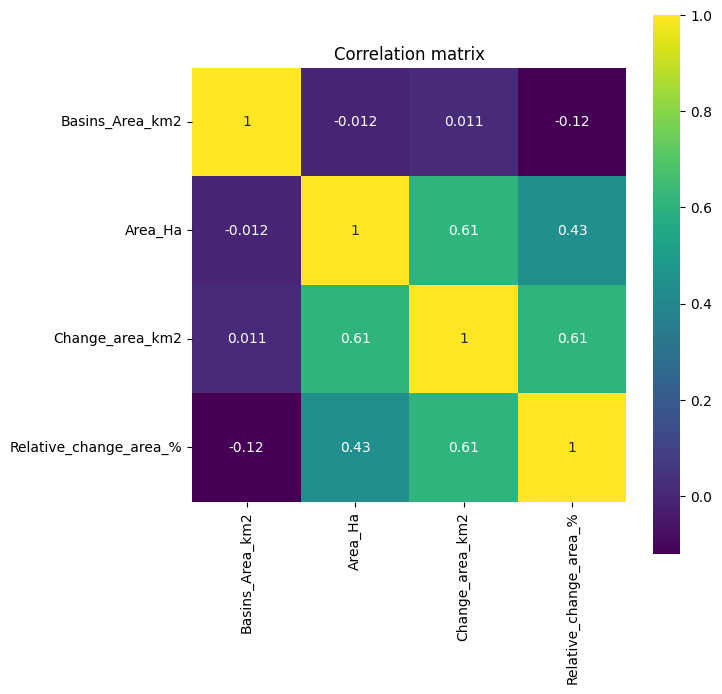

In [73]:
correlation = Iberia_CLC_CHA1218.corr(numeric_only=True)
plt.figure(figsize = (7,7))
ax = sns.heatmap(correlation, vmax =1, square=True, annot=True, cmap = 'viridis')
plt.title('Correlation matrix')
plt.show()

Here is evident the relation between the LULC change area and the relative LULC change within a basin.

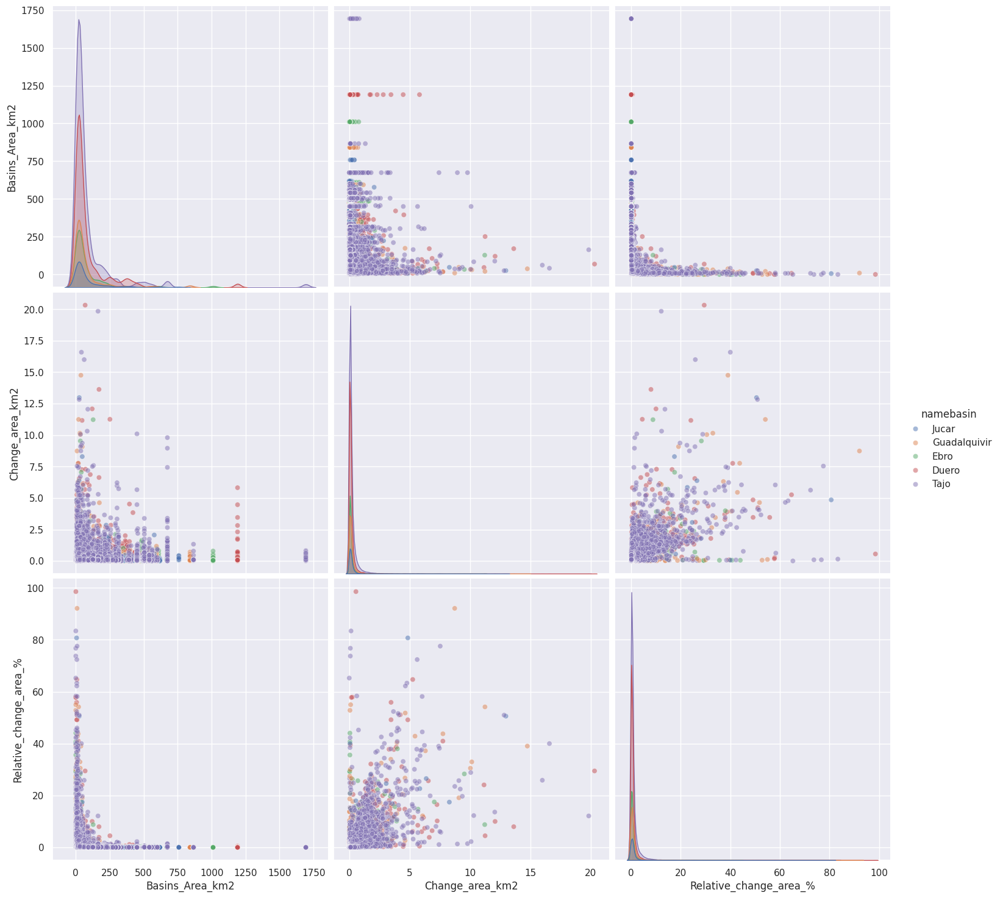

In [74]:
# Reset seaborn theme to default - 55 s
sns.set_theme()


small2big = ['Jucar', 'Guadalquivir',  'Ebro', 'Duero', 'Tajo']  #- 55 s
pairplot = sns.pairplot(Iberia_CLC_CHA1218[['namebasin', 'Basins_Area_km2', 'Change_area_km2', 'Relative_change_area_%']], hue='namebasin', hue_order=small2big, height=5, plot_kws=dict(alpha=0.5))

# Display the pairplot
plt.show()

Pairplots are used in data analysis and visualisation when we are becoming familiar with the data, as they summarise a large amount of data in a single figure.
> The same figure can be created but using logarithmic scale, so that certain details can be observed


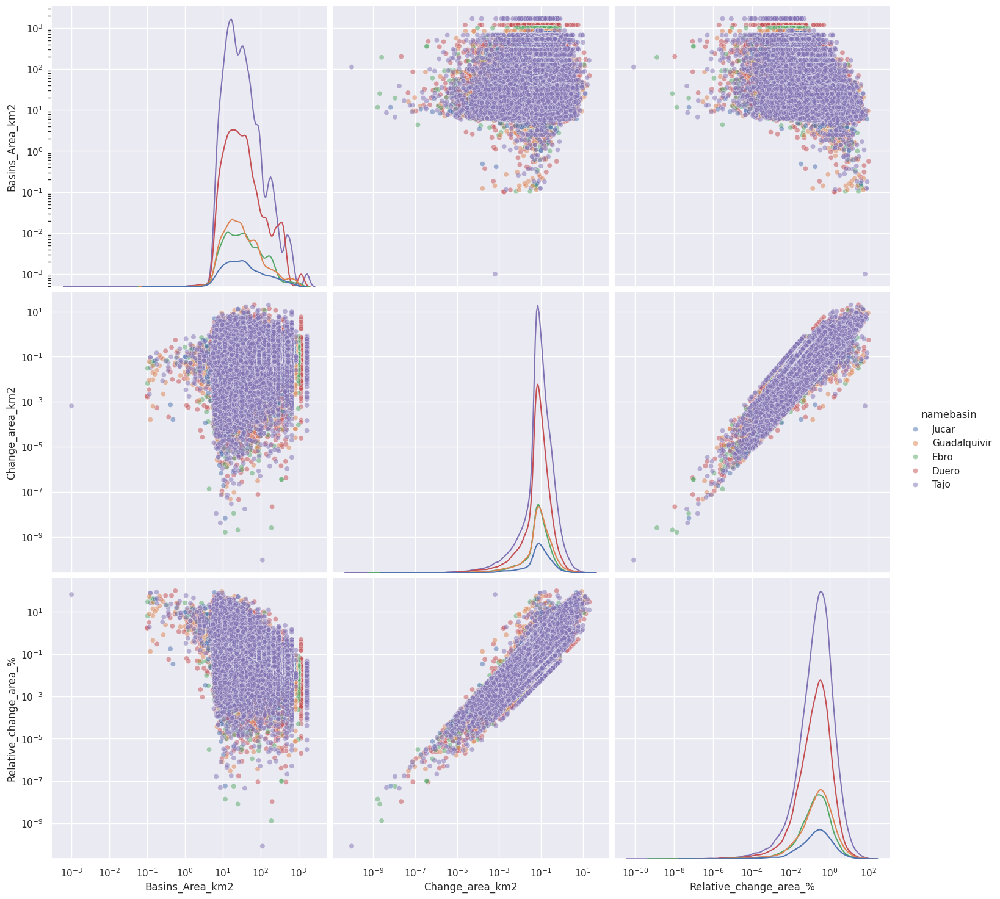

In [75]:
# Reset seaborn theme to default - 55 s
sns.set_theme()
small2big = ['Jucar', 'Guadalquivir',  'Ebro', 'Duero', 'Tajo']  #- 55 s
pairplot = sns.pairplot(Iberia_CLC_CHA1218[['namebasin', 'Basins_Area_km2', 'Change_area_km2', 'Relative_change_area_%']], hue='namebasin', hue_order=small2big, height=5, plot_kws=dict(alpha=0.5), diag_kws=dict(fill=False, log_scale=True))

# Set both x and y axes to log scale
for ax in pairplot.axes.flatten():
    ax.set_xscale('log')
    ax.set_yscale('log')


# Display the pairplot
plt.show()

Now, it's easier to identify the relation between features.
> All variables are right-skewed (i.e. they has asymmetrical distributions with a long right tail).

> The distribution of basins area in the different major basin zones is similar.

> The information for each mbz overlaps, thus no clusters can be clearly differentiated.

> On a logarithmic scale, the linear relationship between the change area and the relative change area can already be observed.


>>> Do you have any comments on these graphs that you would like to add? Please feel free to do so.

### Estimate the curve number variation factors and limits for the variation in curve number in each LULC change area.

$$ CN_{(LULC,\ Slope ,\ HGS)}\ =\frac{CN_{new, max} - CN_{old, max}}{100} $$




The curve number variation factors are estimated as follows:


 - Maximum variation factor of the curve number (CNmaxVF):


$$ CNmaxVF =\frac{CN_{new, max} - CN_{old, max}}{100} $$

- Minimum variation factor of the curve number (CNminVF):

$$ CNminVF= \frac{CN_{new, min} - CN_{old, min}}{100} $$

> $CN_{new, max}$, $CN_{old, max}$, $CN_{new, min}$ & $CN_{old, min}$ : Maximum and minimum values of CN for a Corine Land Cover class independent of the slope or the hidrologic soil group.

The __upper limit__ for the variation in curve number in each LULC change area is estimated as the relative change area in percentage [%] multiplied by the CNmaxVF, the __lower limit__ is estimated in a similar way but multiplied by the CNminVF.

In [76]:
# Extract the maximum values of CN for a Corine Land Cover class independent of the slope or the hidrologic soil group
corine_classes_max = corine_classes.groupby('Code_level_3').max(numeric_only=True).loc[:, 'CN_D']
corine_classes_max.index = corine_classes_max.index.astype('str')
# Extract the minimum values of CN for a Corine Land Cover class independent of the slope or the hidrologic soil group
corine_classes_min = corine_classes.groupby('Code_level_3').min(numeric_only=True).loc[:, 'CN_A']
corine_classes_min.index = corine_classes_min.index.astype('str')

# Estimate the Maximum variation factor of the curve number (CNmaxVI) and add a column with this data to the GeoDataFrame
Iberia_CLC_CHA1218['CNmaxVF'] = None
CNmax_new = corine_classes_max.loc[Iberia_CLC_CHA1218['Code_18']]
CNmax_old = corine_classes_max.loc[Iberia_CLC_CHA1218['Code_12']]

Iberia_CLC_CHA1218['CNmaxVF'] = (CNmax_new.values - CNmax_old.values ) / 100

del CNmax_new # delete unused variables
del CNmax_old # delete unused variables

# Estimate the minimum variation factor of the curve number (CNminVI) and add a column with this data to the GeoDataFrame

Iberia_CLC_CHA1218['CNminVF'] = None
CNmin_new = corine_classes_min.loc[Iberia_CLC_CHA1218['Code_18']]
CNmin_old = corine_classes_min.loc[Iberia_CLC_CHA1218['Code_12']]
Iberia_CLC_CHA1218['CNminVF'] = (CNmin_new.values - CNmin_old.values ) / 100
del CNmin_new  # delete unused variables
del CNmin_old # delete unused variables

# Estimate the upper and lower limit for CN variation and add a column with this data to the GeoDataFrame
Iberia_CLC_CHA1218['CNmaxVFxRCA'] = None
Iberia_CLC_CHA1218['CNminVFxRCA'] = None
Iberia_CLC_CHA1218['CNmaxVFxRCA'] = Iberia_CLC_CHA1218['CNmaxVF'] * Iberia_CLC_CHA1218['Relative_change_area_%']
Iberia_CLC_CHA1218['CNminVFxRCA'] = Iberia_CLC_CHA1218['CNminVF'] * Iberia_CLC_CHA1218['Relative_change_area_%']
Iberia_CLC_CHA1218['CN_change_upper_limit'] = None
Iberia_CLC_CHA1218['CN_change_lower_limit'] = None
Iberia_CLC_CHA1218['CN_change_upper_limit'] = Iberia_CLC_CHA1218.loc[:, ['CNmaxVFxRCA','CNminVFxRCA']].max(axis=1)
Iberia_CLC_CHA1218['CN_change_lower_limit'] = Iberia_CLC_CHA1218.loc[:, ['CNmaxVFxRCA','CNminVFxRCA']].min(axis=1)

Iberia_CLC_CHA1218 = Iberia_CLC_CHA1218.drop(['CNmaxVFxRCA','CNminVFxRCA'], axis=1)


# Show the GeoDatFrame
Iberia_CLC_CHA1218

,h1_id,namebasin,h3_id,h4_id,h5_id,h6_id,h2_id,h7_id,PFAFSTETER,Basin_ID,...,Chtype,Remark,Area_Ha,geometry,Change_area_km2,Relative_change_area_%,CNmaxVF,CNminVF,CN_change_upper_limit,CN_change_lower_limit
0,EU1H100202,Duero,None,None,None,None,EU1H201753,None,None,Duer100000,...,R,None,14.778336,"POLYGON ((3041529.679 2046579.183, 3041498.750...",0.001609,1.588079,-0.04,-0.16,-0.063523,-0.254093
1,EU1H100202,Duero,EU1H304850,None,None,None,EU1H201753,None,None,Duer102377,...,R,None,14.778336,"POLYGON ((3041525.000 2046650.000, 3041521.179...",0.000013,0.000075,-0.04,-0.16,-0.000003,-0.000012
2,EU1H100348,Tajo,EU1H304842,None,None,None,EU1H202800,None,None,Tajo104840,...,R,None,14.778336,"POLYGON ((3041575.000 2046700.000, 3041575.000...",0.006216,0.024925,-0.04,-0.16,-0.000997,-0.003988
3,EU1H100348,Tajo,EU1H304842,EU1H404209,None,None,EU1H202800,None,None,Tajo106006,...,R,None,14.778336,"MULTIPOLYGON (((3041575.000 2046650.000, 30416...",0.139946,0.593468,-0.04,-0.16,-0.023739,-0.094955
4,EU1H100202,Duero,EU1H304711,None,None,None,EU1H201753,None,None,Duer100003,...,R,None,51.563018,"POLYGON ((3032675.000 2053075.000, 3032650.000...",0.090608,39.470803,-0.08,-0.06,-2.368248,-3.157664
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52889,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107721,...,R,None,11.623067,"POLYGON ((2769667.730 1808820.280, 2769702.240...",0.116231,0.021478,-0.07,-0.04,-0.000859,-0.001503
52890,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107721,...,R,None,44.924097,"POLYGON ((2788942.550 1855442.900, 2789015.030...",0.449241,0.083016,-0.17,-0.37,-0.014113,-0.030716
52891,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107722,...,R,None,9.283691,"POLYGON ((2828149.430 1909568.130, 2828147.680...",0.092837,0.073857,-0.08,-0.27,-0.005909,-0.019942
52892,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107722,...,R,None,10.907737,"POLYGON ((2829355.780 1909567.600, 2829346.640...",0.109077,0.086778,0.08,0.27,0.023430,0.006942


Analise the data


In [77]:
nan_count = Iberia_CLC_CHA1218['CN_change_lower_limit'].isna().sum()  # Count NaNs
null_count =Iberia_CLC_CHA1218['CN_change_lower_limit'].isnull().sum()  # Count NaNs and Nones
print('')
print("NaN count:", nan_count)
print("Null count:", null_count)


NaN count: 0
Null count: 0


In [78]:
nan_count = Iberia_CLC_CHA1218['CN_change_upper_limit'].isna().sum()  # Count NaNs
null_count =Iberia_CLC_CHA1218['CN_change_upper_limit'].isnull().sum()  # Count NaNs and Nones
print("NaN count:", nan_count)
print("Null count:", null_count)

NaN count: 0
Null count: 0


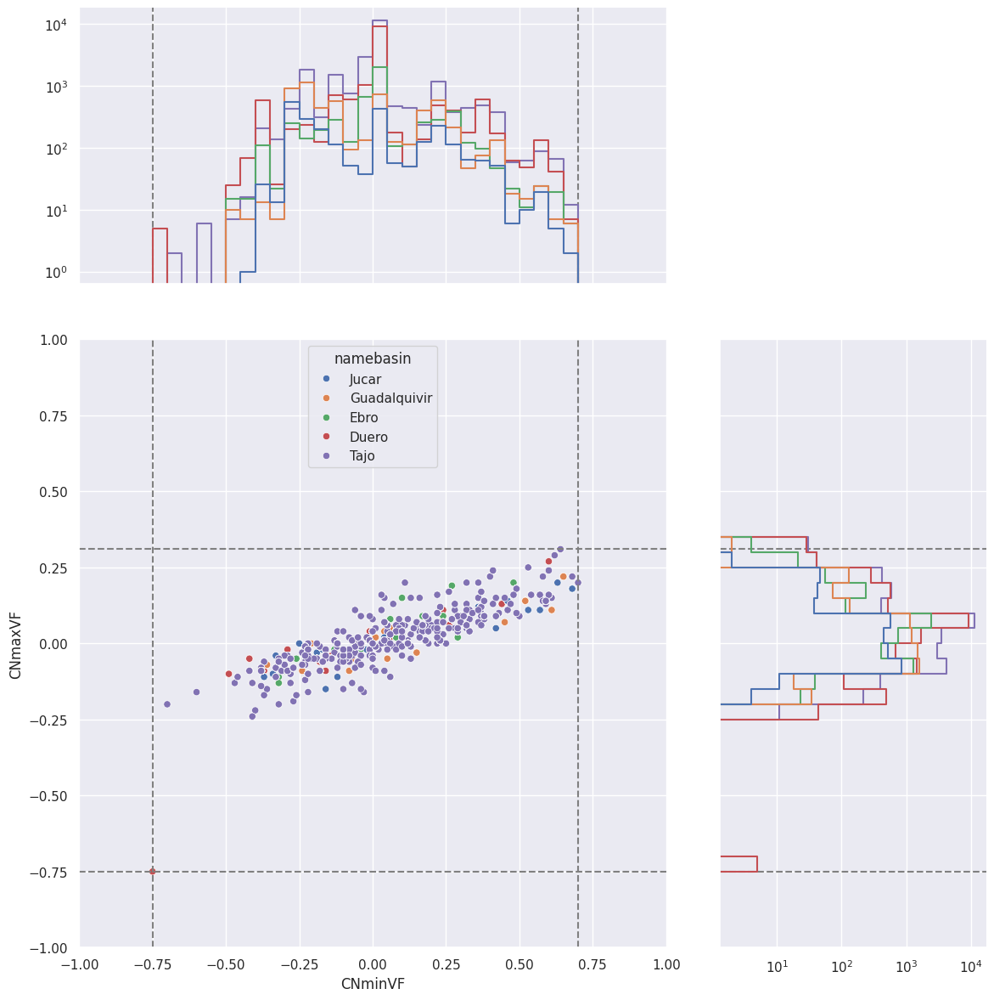

In [79]:
small2big = ['Jucar', 'Guadalquivir',  'Ebro', 'Duero', 'Tajo']

g = sns.JointGrid(data=Iberia_CLC_CHA1218[['namebasin', 'CNmaxVF', 'CNminVF']], x='CNminVF', y='CNmaxVF', hue='namebasin', hue_order=small2big,  height=12, ratio=2, xlim=(-1, 1), ylim=(-1, 1), marginal_ticks=True)
g.refline(x=Iberia_CLC_CHA1218['CNminVF'].max(), y=Iberia_CLC_CHA1218['CNmaxVF'].max())
g.refline(x=Iberia_CLC_CHA1218['CNminVF'].min(), y=Iberia_CLC_CHA1218['CNmaxVF'].min())
g.plot_joint(sns.scatterplot)
g.plot_marginals(sns.histplot, binwidth=0.05, binrange=(-1,1), fill=False, element="step")

# Set log scale for count axis
g.ax_marg_x.set_yscale('log')
g.ax_marg_y.set_xscale('log')


In [80]:
import plotly.express as px
import plotly.graph_objects as go


# Create subplots with different axes
fig = go.Figure()

small2big = ['Jucar', 'Guadalquivir',  'Ebro', 'Duero', 'Tajo']
colors1 = [
    'rgb(0, 0, 255)',   # Blue
    'rgb(255, 0, 0)',   # Red
    'rgb(34, 139, 34)',  # Forest Green
    'rgb(255, 165, 0)', # Orange
    'rgb(0, 128, 128)'  # Teal
]

colors2 = [
    'rgb(204, 85, 0)',   # Burnt Orange
    'rgb(0, 102, 102)',  # Dark Cyan
    'rgb(102, 0, 102)',  # Plum
    'rgb(0, 0, 128)',    # Navy Blue
    'rgb(227, 66, 52)'  # Vermilion
]


for mbz_name, COLOR1, COLOR2 in zip(small2big,colors1, colors2 ):
  legend1= mbz_name + ' upper limit'
  legend2= mbz_name + ' lower limit'
  # Add traces for each variable
  fig.add_trace(go.Violin(y = Iberia_CLC_CHA1218['namebasin'].loc[Iberia_CLC_CHA1218['namebasin']==mbz_name], x=Iberia_CLC_CHA1218['CN_change_upper_limit'].loc[Iberia_CLC_CHA1218['namebasin']==mbz_name ],  legendgroup='Upper_limit', scalegroup='Upper_limit', name=legend1,
                        side='positive',line_color=COLOR2, pointpos=1, orientation='h', marker=dict(symbol='line-ns-open')))
  fig.add_trace(go.Violin(y = Iberia_CLC_CHA1218['namebasin'].loc[Iberia_CLC_CHA1218['namebasin']==mbz_name], x=Iberia_CLC_CHA1218['CN_change_lower_limit'].loc[Iberia_CLC_CHA1218['namebasin']==mbz_name ], legendgroup='Lower_limit', scalegroup='Lower_limit', name=legend2,
                        side='negative', line_color=COLOR1, pointpos=-1, orientation='h', marker=dict(symbol='line-ns-open')))



# Update the layout to enhance the aesthetics
fig.update_layout(title="Limits for CN variation in a basin due to each discrete LULC change area", xaxis_title='Possible CN variation', height=1080, margin=dict(l=50, r=50, t=50, b=50))
fig.update_traces(meanline_visible=True)
fig.update_layout(violingap=0, violinmode='overlay')
# Show plot
fig.show()

### Estimate the highest absolute variance (HAV) and the smallest absolute variance (SAV) for each basin

Extract relevant features for the affected basins

In [81]:
# Filter the relevant features
Affected_basins = Iberia_CLC_CHA1218.loc[:, ['Basin_ID', 'Relative_change_area_%', 'CN_change_upper_limit', 'CN_change_lower_limit']]
# Sum the relative change area by basin
Affected_basins = Affected_basins.groupby('Basin_ID').sum()


# Assing the corresponding basin geometry
iberia_basins_gdf.index = iberia_basins_gdf.loc[:, 'Basin_ID']
crs_IP = iberia_basins_gdf.crs
Affected_basins =  gpd.GeoDataFrame(data=Affected_basins, geometry=iberia_basins_gdf.loc[Affected_basins.index].geometry, crs=crs_IP)
Affected_basins

,Relative_change_area_%,CN_change_upper_limit,CN_change_lower_limit,geometry
Basin_ID,,,,
Duer100000,1.588079,-0.063523,-0.254093,"MULTIPOLYGON (((3041514.215 2046385.631, 30415..."
Duer100003,39.470803,-2.368248,-3.157664,"MULTIPOLYGON (((3032153.334 2053840.916, 30321..."
Duer100012,0.296748,0.020772,0.011870,"MULTIPOLYGON (((2927287.023 2068891.326, 29274..."
Duer100042,2.309672,0.161677,0.092387,"MULTIPOLYGON (((2761525.000 2178150.000, 27615..."
Duer100044,0.364273,0.025499,0.014571,"MULTIPOLYGON (((2764075.000 2185722.560, 27640..."
...,...,...,...,...
Tajo107712,0.259868,0.083158,0.015592,"MULTIPOLYGON (((3024182.484 1895630.528, 30241..."
Tajo107717,0.513788,0.040775,-0.008262,"MULTIPOLYGON (((2721450.000 1769200.000, 27214..."
Tajo107718,0.194108,0.050468,0.009705,"MULTIPOLYGON (((3126925.000 2059200.000, 31268..."


Estimate highest absolute variance (HAV), the smallest absolute variance (SAV)  and the range of possible variation for each basin.

> We are going to use the [numpy](https://numpy.org/) library.

In [85]:
import numpy as np

In [86]:
Affected_basins['HAV'] =  None
Affected_basins['SAV'] = None
Affected_basins['Var_range'] = None

Affected_basins['HAV'] = np.where(Affected_basins['CN_change_upper_limit'].abs() >= Affected_basins['CN_change_lower_limit'].abs(), Affected_basins['CN_change_upper_limit'], Affected_basins['CN_change_lower_limit'])
Affected_basins['SAV'] = np.where(Affected_basins['CN_change_upper_limit'].abs() <= Affected_basins['CN_change_lower_limit'].abs(), Affected_basins['CN_change_upper_limit'], Affected_basins['CN_change_lower_limit'])
Affected_basins['Var_range'] = abs(Affected_basins['CN_change_upper_limit'] - Affected_basins['CN_change_lower_limit'])
Affected_basins

,Relative_change_area_%,CN_change_upper_limit,CN_change_lower_limit,geometry,HAV,SAV,Var_range
Basin_ID,,,,,,,
Duer100000,1.588079,-0.063523,-0.254093,"MULTIPOLYGON (((3041514.215 2046385.631, 30415...",-0.254093,-0.063523,0.190569
Duer100003,39.470803,-2.368248,-3.157664,"MULTIPOLYGON (((3032153.334 2053840.916, 30321...",-3.157664,-2.368248,0.789416
Duer100012,0.296748,0.020772,0.011870,"MULTIPOLYGON (((2927287.023 2068891.326, 29274...",0.020772,0.011870,0.008902
Duer100042,2.309672,0.161677,0.092387,"MULTIPOLYGON (((2761525.000 2178150.000, 27615...",0.161677,0.092387,0.069290
Duer100044,0.364273,0.025499,0.014571,"MULTIPOLYGON (((2764075.000 2185722.560, 27640...",0.025499,0.014571,0.010928
...,...,...,...,...,...,...,...
Tajo107712,0.259868,0.083158,0.015592,"MULTIPOLYGON (((3024182.484 1895630.528, 30241...",0.083158,0.015592,0.067566
Tajo107717,0.513788,0.040775,-0.008262,"MULTIPOLYGON (((2721450.000 1769200.000, 27214...",0.040775,-0.008262,0.049037
Tajo107718,0.194108,0.050468,0.009705,"MULTIPOLYGON (((3126925.000 2059200.000, 31268...",0.050468,0.009705,0.040763


Calculate how many basins could have an absolute variation greater than one CN unit in the critical case.

In [87]:
len(Affected_basins['HAV'].loc[Affected_basins['HAV'].abs()  > 1])

1143

In [88]:
Affected_basins['HAV'].loc[Affected_basins['HAV'].abs() > 1].describe()

count    1143.000000
mean        1.057732
std         5.406862
min       -22.118146
25%        -1.501774
50%         1.091396
75%         2.014926
max        39.199798
Name: HAV, dtype: float64

In [89]:
Affected_basins['HAV'].loc[Affected_basins['HAV'].abs() > 1].abs().describe()

count    1143.000000
mean        3.104528
std         4.550538
min         1.000606
25%         1.250245
50%         1.714582
75%         2.781313
max        39.199798
Name: HAV, dtype: float64

Calculate how many basins could have an absolute variation greater than one CN unit in the less critical case.

In [90]:
len(Affected_basins['SAV'].loc[Affected_basins['SAV'].abs()  > 1])

312

In [91]:
Affected_basins['SAV'].loc[Affected_basins['SAV'].abs() > 1].describe()

count    312.000000
mean       2.408606
std        4.704156
min       -5.895040
25%        1.011689
50%        1.502467
75%        2.829293
max       22.696981
Name: SAV, dtype: float64

In [92]:
Affected_basins['SAV'].loc[Affected_basins['SAV'].abs() > 1].abs().describe()

count    312.000000
mean       3.337284
std        4.095832
min        1.000256
25%        1.246463
50%        1.756658
75%        3.258043
max       22.696981
Name: SAV, dtype: float64

### Map the results over the Iberian Peninsula

First, map the **relative change area [%]**.

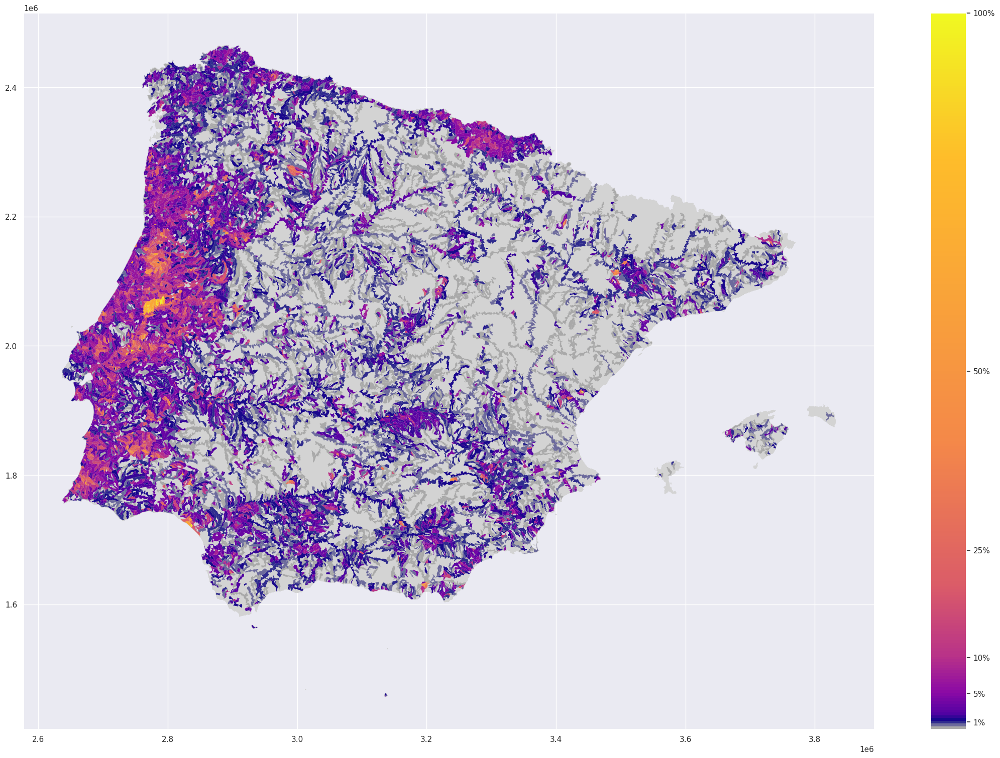

In [93]:
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

# Create a figure and a grid of subplots - 1 min
fig, ax = plt.subplots(1, 1, figsize=(25, 15), sharex=True, sharey=True, layout='constrained')

# Plot the basins
iberia_basins_gdf.plot(ax=ax, color="lightgrey", edgecolor="lightgrey", zorder=1)

# Define colormap

colors = [(0.0, 'darkgrey'),
          (0.01, '#0d0887'),
 (0.02, '#5302a3'),
 (0.05, '#8b0aa5'),
 (0.10, '#b83289'),
 (0.20, '#db5c68'),
 (0.40, '#f48849'),
 (0.80, '#febd2a'),
 (1.0, '#f0f921')]

cmap = LinearSegmentedColormap.from_list('custom', colors)

# Plot selected basins emphasizing values > 1%
Affected_basins.plot(ax=ax, column='Relative_change_area_%', cmap=cmap, legend=True, vmin=0, vmax=100, legend_kwds={'ticks': [1, 5, 10, 25, 50, 100], 'format': '%d%%'},linewidth=0, zorder=2 )


plt.show()

Map the **possible highest absolute variation of CN**.

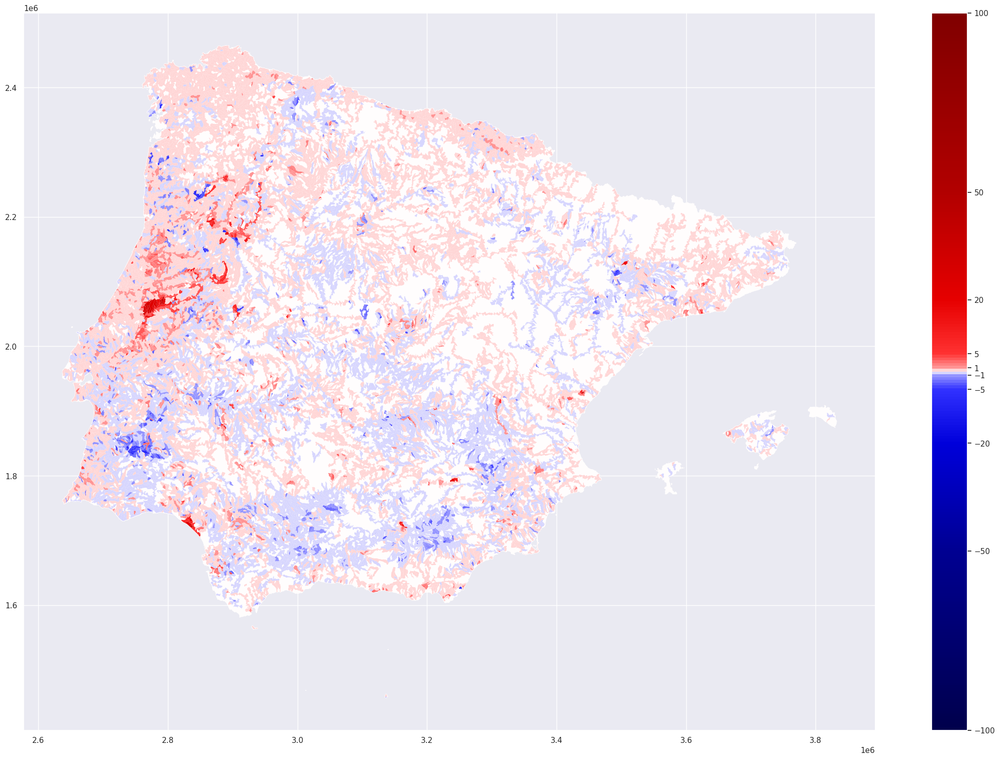

In [94]:
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

# Create a figure and a grid of subplots
fig, ax = plt.subplots(1, 1, figsize=(25, 15), sharex=True, sharey=True, layout='constrained')

# Plot the basins
iberia_basins_gdf.plot(ax=ax, color='#fffdfd', edgecolor='#fffdfd', zorder=1)

colors = [(0.0, '#00004c'),
 (0.25, '#000092'),
 (0.4, '#0000db'),
 (0.475, '#3131ff'),
 (0.495, '#9999ff'),
 (0.5, '#fffdfd'),
 (0.505, '#ff9999'),
 (0.525, '#ff3131'),
 (0.6, '#e60000'),
 (0.75, '#b20000'),
 (1.0, '#800000')]



cmap = LinearSegmentedColormap.from_list('custom', colors)




# Plot selected basins emphasizing values > 5%
Affected_basins.plot(ax=ax, column='HAV', cmap=cmap, legend=True, vmin=-100, vmax=100, legend_kwds={'ticks': [-100, -50, -20, -5, -1, 1, 5, 20, 50, 100]},linewidth=0, zorder=2 )


plt.show()

Map the **possible smallest absolute variation of CN**.

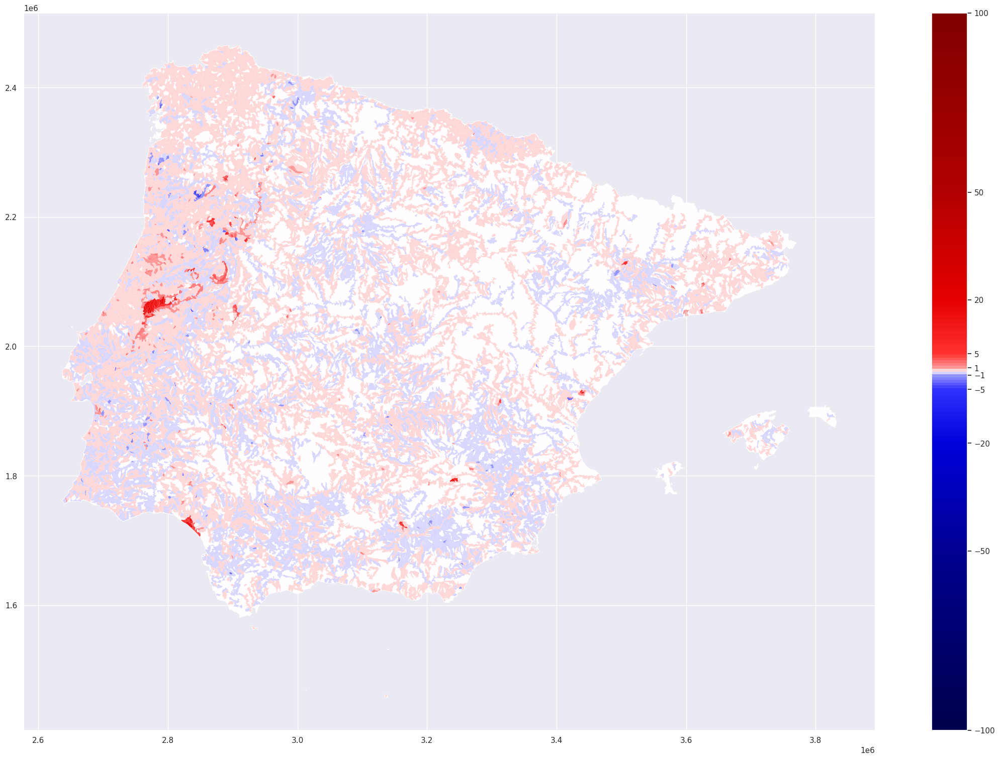

In [95]:
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

# Create a figure and a grid of subplots
fig, ax = plt.subplots(1, 1, figsize=(25, 15), sharex=True, sharey=True, layout='constrained')

# Plot the basins
iberia_basins_gdf.plot(ax=ax, color='#fffdfd', edgecolor='#fffdfd', zorder=1)

colors = [(0.0, '#00004c'),
 (0.25, '#000092'),
 (0.4, '#0000db'),
 (0.475, '#3131ff'),
 (0.495, '#9999ff'),
 (0.5, '#fffdfd'),
 (0.505, '#ff9999'),
 (0.525, '#ff3131'),
 (0.6, '#e60000'),
 (0.75, '#b20000'),
 (1.0, '#800000')]



cmap = LinearSegmentedColormap.from_list('custom', colors)




# Plot selected basins emphasizing values > 5%
Affected_basins.plot(ax=ax, column='SAV', cmap=cmap, legend=True, vmin=-100, vmax=100, legend_kwds={'ticks': [-100, -50, -20, -5, -1, 1, 5, 20, 50, 100]},linewidth=0, zorder=2 )


plt.show()

Map the **range for the possible absolute variation of CN in each basin**.

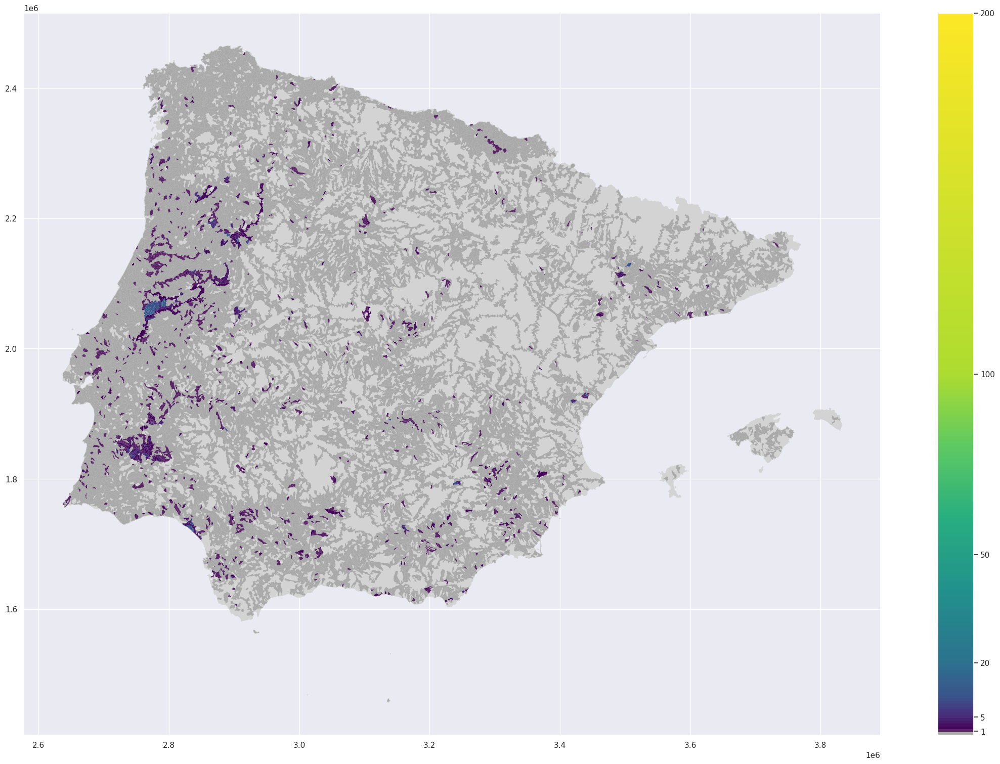

In [96]:
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

# Create a figure and a grid of subplots
fig, ax = plt.subplots(1, 1, figsize=(25, 15), sharex=True, sharey=True, layout='constrained')

# Plot the basins
iberia_basins_gdf.plot(ax=ax, color="lightgrey", edgecolor="lightgrey", zorder=1)

colors = [(0.0, 'darkgrey'),
 (0.005, '#440154'),
 (0.025, '#472d7b'),
 (0.05, '#3b528b'),
 (0.10, '#2c728e'),
 (0.20, '#21918c'),
 (0.30, '#28ae80'),
 (0.40, '#5ec962'),
 (0.50, '#addc30'),
 (1.0, '#fde725')]



cmap = LinearSegmentedColormap.from_list('custom', colors)




# Plot selected basins emphasizing values > 5%
Affected_basins.plot(ax=ax, column='Var_range', cmap=cmap, legend=True, vmin=0, vmax=200, legend_kwds={'ticks': [1, 5, 20, 50, 100, 200]},linewidth=0, zorder=2 )


plt.show()

### Save the GeoDataframe of affected basins in the Iberian Peninsula

In [97]:
Affected_basins.to_file('/content/drive/MyDrive/Iberia_project/03_Results/Iberia_Affected_basins_CLC_CHA_1218.gpkg', driver='GPKG', layer='Affected_subbasins', engine= 'pyogrio')

## Visually identify the __LULC change processes__ in the Iberian Peninsula

The data we have gathered is very useful for exploring, identifying and visualising patterns related to LULC change processes.

### Plot the Iberian Peninsula LULC change QR code

Now, let's take a look at the matrix of CORINE thematic classes changes.

In [98]:


# Create a numpy array filled with zeros
base_matrix = np.full((44, 44), 0)

# Convert the numpy array to a Pandas DataFrame
change_matrix = pd.DataFrame(base_matrix)

# Extract a DataFrame with unique CORINE thematic classes and the groups for change processes identification
unique_classes = corine_classes[[ 'Group_for_change_processes_identification', 'Code_level_3']]
unique_classes = unique_classes.drop_duplicates('Code_level_3')



# Define the index and columns names as CORINE thematic classes

change_matrix.index = pd.Index(data=unique_classes['Code_level_3'], dtype='string')
change_matrix.columns =  change_matrix.index

# Estimate the change area for each LULC change combination
for x, y in Iberia_CLC_CHA1218.groupby(by="Change"):
  change_matrix.at[y['Code_12'].iloc[0], y['Code_18'].iloc[0]] = y['Relative_change_area_%'].sum()

# Define a MultiIndex index and columns for CORINE thematic classes and groups for change processes identification
change_matrix.index = pd.MultiIndex.from_frame(unique_classes)
change_matrix.index = change_matrix.index.set_levels(change_matrix.index.levels[1].astype(str), level=1)
change_matrix.columns =  change_matrix.index
change_matrix.index = change_matrix.index.set_names(['Old_LULC_Group', 'Old_Corine_class'])
change_matrix.columns = change_matrix.columns.set_names(['New_LULC_Group', 'New_Corine_class'])
change_matrix

New_LULC_Group                        Urban                          \
New_Corine_class                        111         112         121   
Old_LULC_Group   Old_Corine_class                                     
Urban            111               0.000000    0.000000    0.000000   
                 112               0.000000    0.000000    0.000000   
                 121               0.000000    0.000000    0.000000   
                 122               0.000000    0.438879    0.039626   
                 123               0.000000    0.000000    0.000000   
                 124               0.000000    0.000000    0.000000   
                 131               0.000000    0.070640    1.278252   
                 132               0.000000    0.000000    0.741217   
                 133               5.594681  200.106387  264.332817   
                 141               0.000000    0.000000    0.000000   
                 142               0.000000    0.000000    0.000000   
Cropland         211               0.000000    3.700376   37.729700   
                 212               0.307492    0.125487   17.718419   
                 213               0.000000    0.000000    0.000000   
                 221               0.000000    1.238181    4.376481   
                 222               0.000000    0.099165    2.006587   
                 223               0.000000    0.628637    2.430694   
                 231               0.000000    7.138109   35.603469   
                 241               0.000000    0.612742    1.161918   
                 242               0.000000    0.431272    4.384198   
                 243               0.000000    0.884675    1.006696   
                 244               0.000000    0.000000    2.411930   
Forest           311               0.000000    1.031115   11.088569   
                 312               0.000000    1.716493    5.767698   
                 313               0.000000    0.657216    4.413933   
Other vegetation 321               0.000000    0.320975    3.171292   
                 322               0.000000    0.187404    2.048614   
                 323               0.000000    0.018315    3.005750   
                 324               0.000000    0.334630   15.113728   
Bare             331               0.000000    0.000000    0.000000   
                 332               0.000000    0.000000    0.000000   
                 333               0.000000    0.000000    0.995508   
Burnt            334               0.000000    0.000000    0.073880   
Glacier          335               0.000000    0.000000    0.000000   
Wetland          411               0.000000    0.000000    0.000000   
                 412               0.000000    0.000000    0.000000   
                 421               0.000000    0.000000    0.000000   
                 422               0.000000    0.000000    0.000000   
                 423               0.000000    0.000000    0.000000   
Water            511               0.000000    0.000000    0.000000   
                 512               0.000000    0.000000    0.000000   
                 521               0.000000    0.000000    0.000000   
                 522               0.000000    0.000000    0.000000   
                 523               0.000000    0.000000    0.000000   

New_LULC_Group                                                                 \
New_Corine_class                          122        123       124        131   
Old_LULC_Group   Old_Corine_class                                               
Urban            111                 0.000000   0.000000  0.000000   0.000000   
                 112                 0.000000   0.000000  0.000000   0.000000   
                 121                 0.217446  17.445498  0.000000   0.042406   
                 122                 0.000000   0.000000  0.000000   0.000000   
                 123                 0.000000   0.000000  0.000000   0.000000   
              

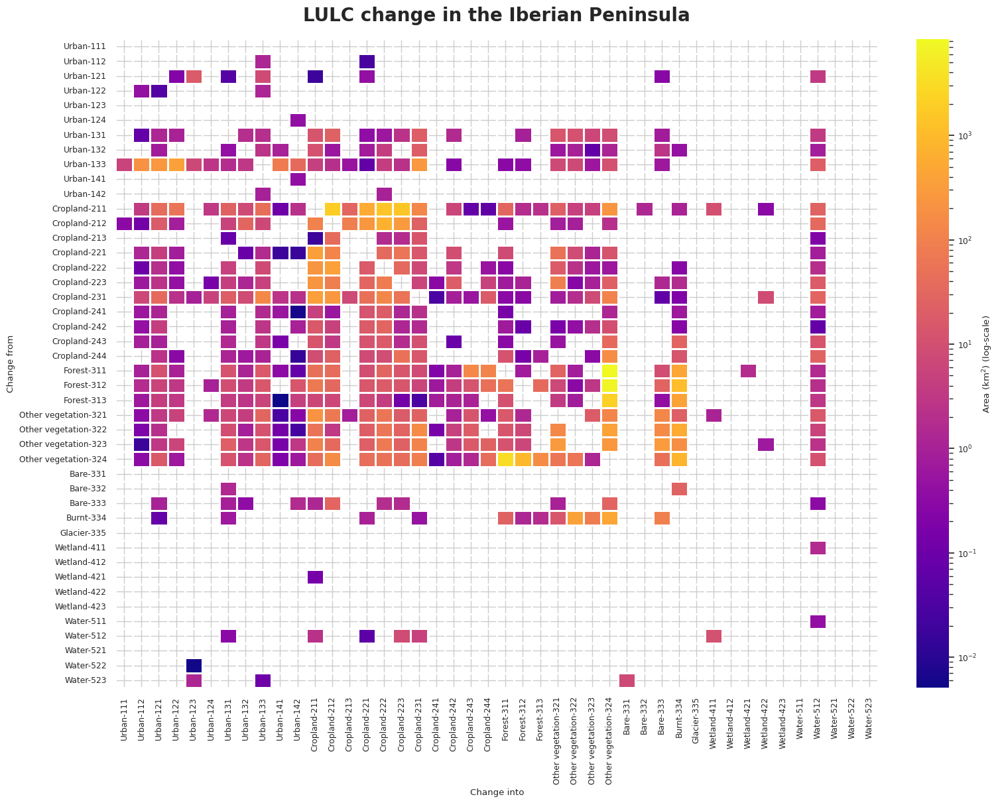

In [99]:
# Plot using matplotlib and Seaborn
from matplotlib.colors import LogNorm

sns.set_theme(style="whitegrid")
sns.set_context("notebook", font_scale=0.8, rc={"lines.linewidth": 0.5})

fig, ax = plt.subplots(figsize=(15, 12), layout='constrained')
    # Plot the raster using rasterio's show function with the custom colormap

# Get the min and max values
v_min = change_matrix[change_matrix > 0].min().min()
v_max = change_matrix.max().max()

# Plot a heatmap
heatmap = sns.heatmap(change_matrix, linewidths=0.75, norm=LogNorm(vmin = v_min, vmax= v_max), cmap='plasma')

# Set the labels and titles
ax.set_title('LULC change in the Iberian Peninsula', pad=20, fontsize = 20, fontweight='semibold');
cbar = heatmap.collections[0].colorbar
cbar.set_label('Area (km$^2$) (log-scale)');
plt.xlabel('Change into');
plt.ylabel('Change from');


> We call this graph "the Iberian Peninsula QR code" because of its resemblance to a QR code. Actually, you can't get a link by scanning it. It doesn't work like a real QR code!

### Plot LULC change signature for each major basin zone

In [100]:
### CHANGE MATRIX CODE


# Flat change matrix
change_matrix_flat =  change_matrix.stack().stack().reset_index()
# Rename the column
change_matrix_flat = change_matrix_flat.rename(columns={0: 'IP_Change_area_km2'})

## Drop the level 0 of the MultiIndex
change_matrix_b = change_matrix.droplevel(0, axis=0)
change_matrix_b = change_matrix_b.droplevel(0, axis=1)


BZ_names = ['Duero', 'Guadalquivir','Jucar', 'Tajo', 'Ebro']

# Group by basin zone name
c_i = 0
for XX, YY in Iberia_CLC_CHA1218.groupby(by="namebasin"):
  change_matrix_bz = pd.DataFrame(0, index=change_matrix_b.index, columns=change_matrix_b.columns)
  # Estimate the change area for each LULC change combination
  for x, y in YY.groupby(by="Change"):
    change_matrix_bz.at[y['Code_12'].iloc[0], y['Code_18'].iloc[0]] = y['Change_area_km2'].sum()
    # Flat the matrix to a long-form
  change_matrix_bz_flat = change_matrix_bz.stack().reset_index()
  # Rename the column
  change_matrix_bz_flat = change_matrix_bz_flat.rename(columns={0: 'Change_area_km2'})

  col_name_ca = BZ_names[c_i] + "_change_area_km2"
  col_name_cont = BZ_names[c_i] + "_proportion"
    # Add the column with the change area in the basin zone at the flattened change matrix
  change_matrix_flat[col_name_ca] = change_matrix_bz_flat['Change_area_km2']
    # Add the column with the proportion of the basin zone change area in the Iberian Peninsula at the flattened change matrix
  change_matrix_flat[col_name_cont] = change_matrix_flat[col_name_ca] / change_matrix_flat['IP_Change_area_km2']

  c_i = c_i + 1
change_matrix_flat


,Old_LULC_Group,Old_Corine_class,New_Corine_class,New_LULC_Group,IP_Change_area_km2,Duero_change_area_km2,Duero_proportion,Guadalquivir_change_area_km2,Guadalquivir_proportion,Jucar_change_area_km2,Jucar_proportion,Tajo_change_area_km2,Tajo_proportion,Ebro_change_area_km2,Ebro_proportion
0,Urban,111,111,Urban,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN
1,Urban,111,112,Urban,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN
2,Urban,111,121,Urban,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN
3,Urban,111,122,Urban,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN
4,Urban,111,123,Urban,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1931,Water,523,511,Water,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN
1932,Water,523,512,Water,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN
1933,Water,523,521,Water,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN
1934,Water,523,522,Water,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN


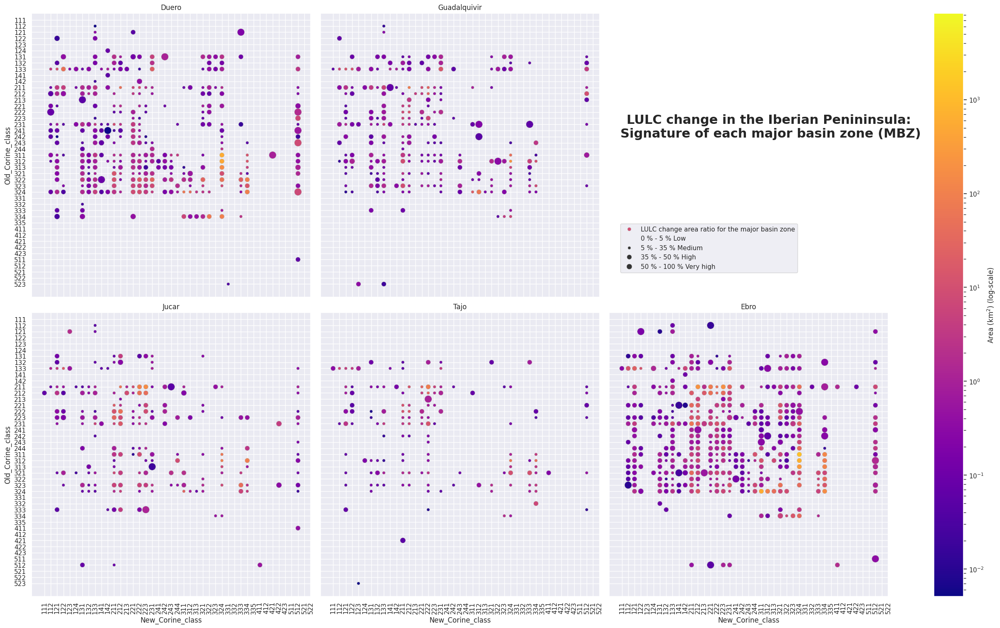

In [101]:
from matplotlib.colors import LogNorm
sns.set_theme(context='notebook', style="darkgrid", palette='deep')


# Create a figure and a grid of subplots (2 rows, 3 columns)
fig, axes = plt.subplots(2, 3, figsize=(24, 15), sharex=True, sharey=True, layout='constrained')

# Get the min and max values for the Iberian peninsula (Use the same color scale)
v_min = change_matrix_flat[change_matrix_flat['IP_Change_area_km2'] > 0]['IP_Change_area_km2'].min()
v_max = change_matrix_flat['IP_Change_area_km2'].max()


  # Define custom breaks and corresponding circle sizes
size_mapping = {
    (0, 0.05): 5,     # Circle size for values between 0 and 5%
    (0.05, 0.35): 35,   # Circle size for values between 5% - 35%, expected ratio for all basin zones
    (0.35, 0.50): 50,   # Circle size for values between 35% - 50%
    (0.50, 1.00): 100,  # Circle size for values between 50% - 100%
    }

BZ_names = ['Duero', 'Guadalquivir','Jucar', 'Tajo', 'Ebro']
### loop for each basin group

loc_axes_x = [0, 0, 1, 1, 1, 0]
loc_axes_y = [0, 1, 0, 1, 2, 2]

c_i = 0
for BZ_name in BZ_names:
    col_name_ca = BZ_names[c_i] + "_change_area_km2"
    col_name_pro = BZ_names[c_i] + "_proportion"
  # Apply the custom size mapping
    change_matrix_flat['size_mapped'] = change_matrix_flat[col_name_pro].apply(lambda x: next((size for (start, end), size in size_mapping.items() if start < x <= end), None))
    change_matrix_flat.loc[change_matrix_flat[col_name_ca] <= 0, col_name_ca] = None

  # Draw each cell as a scatter point with varying size and color
    sns.scatterplot(
        data=change_matrix_flat, ax=axes[loc_axes_x[c_i], loc_axes_y[c_i]],
        x="New_Corine_class", y="Old_Corine_class", hue=col_name_ca, hue_norm = LogNorm(vmin = v_min, vmax= v_max, clip=True ), size="size_mapped",
        palette="plasma", edgecolor=".7",
        sizes=(25, 150)
      )
        # Rotate x-axis tick labels by 45 degrees
    axes[loc_axes_x[c_i], loc_axes_y[c_i]].tick_params(axis='x', rotation=90)
    axes[loc_axes_x[c_i], loc_axes_y[c_i]].set_title(BZ_name)
    axes[loc_axes_x[c_i], loc_axes_y[c_i]].get_legend().set_visible(False)
    c_i = c_i + 1

# Add a color bar
cbar = fig.colorbar(None, ax=axes.ravel().tolist(), norm=LogNorm(vmin = v_min, vmax= v_max, clip=True), cmap='plasma', orientation='vertical')
cbar.set_label('Area (km$^2$) (log-scale)')
# Add legend with offset
handles, labels = axes[1, 1].get_legend_handles_labels()
labels = ['LULC change area ratio for the major basin zone',
          '0 % - 5 % Low',
          '5 % - 35 % Medium',
          '35 % - 50 % High',
          '50 % - 100 % Very high']
handles = handles[4:]
fig.legend(handles, labels, bbox_to_anchor=(0.8, 0.65), loc='upper right')
axes[0, 2].set_axis_off()

# Set the title
# Set a figure title at a specific location
fig.text(0.77, 0.80, 'LULC change in the Iberian Penininsula: \nSignature of each major basin zone (MBZ)', ha='center', va='center', fontsize=22, fontweight='semibold')
plt.show()

### Add the corresponding LULC change group, subgroup and processes to the GeoDataFrame

In [102]:


# Create a numpy array filled with 999s (Not change considered code)
data_base = np.full((44, 44), 999)

# Convert the numpy array to a Pandas DataFrame
change_matrix = pd.DataFrame(data_base)

# Create an array with CORINE thematic classes
clases_code = corine_classes['Code_level_3'].unique()

# Define the index and columns names as CORINE thematic classes
change_matrix.index = clases_code
change_matrix.columns = clases_code

# Iterate over the DataFrame to access values and indices
for i in change_matrix.index:          # Loop over rows
    X = corine_classes.loc[corine_classes['Code_level_3'] == i]
    group_class_X = X.iloc[0]['Group_for_change_processes_identification']
    corine_class_X = X.iloc[0]['Subgroup_for_change_processes_identification']
    for j in change_matrix.columns:  # Loop over columns
        Y = corine_classes.loc[corine_classes['Code_level_3'] == j]
        group_class_Y = Y.iloc[0]['Group_for_change_processes_identification']
        corine_class_Y = Y.iloc[0]['Subgroup_for_change_processes_identification']
        if ((group_class_X == 'Urban') & (group_class_Y == 'Urban')) | ((group_class_X == 'Cropland') & (group_class_Y == 'Cropland')):
          if corine_class_X ==  corine_class_Y:
            None
          else:
            value_row = change_names.loc[(change_names['Before_change'] == corine_class_X) & (change_names['After_change'] == corine_class_Y) ]
            change_matrix.at[i, j] = value_row.Code.iloc[0]
        else:
          if group_class_X == group_class_Y:
            None
          else:
            value_row = change_names.loc[(change_names['Before_change'] == group_class_X) & (change_names['After_change'] == group_class_Y) ]
            change_matrix.at[i, j] = value_row.Code.iloc[0]
# Define the index and columns names as CORINE thematic classes
change_matrix.index = change_matrix.index.astype('str')
change_matrix.columns = change_matrix.index
change_matrix

,111,112,121,122,123,124,131,132,133,141,...,411,412,421,422,423,511,512,521,522,523
111,999,1002,999,999,999,1002,1002,1002,1002,1003,...,1800,1800,1800,1800,1800,1900,1900,1900,1900,1900
112,1001,999,1001,1001,1001,999,999,999,999,1004,...,1800,1800,1800,1800,1800,1900,1900,1900,1900,1900
121,999,1002,999,999,999,1002,1002,1002,1002,1003,...,1800,1800,1800,1800,1800,1900,1900,1900,1900,1900
122,999,1002,999,999,999,1002,1002,1002,1002,1003,...,1800,1800,1800,1800,1800,1900,1900,1900,1900,1900
123,999,1002,999,999,999,1002,1002,1002,1002,1003,...,1800,1800,1800,1800,1800,1900,1900,1900,1900,1900
124,1001,999,1001,1001,1001,999,999,999,999,1004,...,1800,1800,1800,1800,1800,1900,1900,1900,1900,1900
131,1001,999,1001,1001,1001,999,999,999,999,1004,...,1800,1800,1800,1800,1800,1900,1900,1900,1900,1900
132,1001,999,1001,1001,1001,999,999,999,999,1004,...,1800,1800,1800,1800,1800,1900,1900,1900,1900,1900
133,1001,999,1001,1001,1001,999,999,999,999,1004,...,1800,1800,1800,1800,1800,1900,1900,1900,1900,1900
141,1005,1006,1005,1005,1005,1006,1006,1006,1006,999,...,1800,1800,1800,1800,1800,1900,1900,1900,1900,1900


In [103]:
# Extract a DataFrame with unique CORINE thematic classes and the groups for change processes identification
unique_classes = corine_classes[[ 'Group_for_change_processes_identification', 'Subgroup_for_change_processes_identification', 'Code_level_3']]
unique_classes = unique_classes.drop_duplicates('Code_level_3')
unique_classes.index = unique_classes['Code_level_3'].astype('str')

change_names.index = change_names.Code

Iberia_CLC_CHA1218['Change_code'] = None
Iberia_CLC_CHA1218['Change_name'] = None
Iberia_CLC_CHA1218['Old_group'] = None
Iberia_CLC_CHA1218['Old_subgroup'] = None
Iberia_CLC_CHA1218['New_group'] = None
Iberia_CLC_CHA1218['New_subgroup'] = None
for ind, cod12, cod18 in zip(Iberia_CLC_CHA1218.index, Iberia_CLC_CHA1218['Code_12'], Iberia_CLC_CHA1218['Code_18']):
  change_code = change_matrix.at[cod12, cod18]
  Iberia_CLC_CHA1218.at[ind, 'Change_code'] = change_code
  Iberia_CLC_CHA1218.at[ind, 'Change_name'] = change_names.at[change_code, 'Change_process_full_name']
  Iberia_CLC_CHA1218.at[ind, 'Old_group'] = unique_classes.at[cod12, 'Group_for_change_processes_identification']
  Iberia_CLC_CHA1218.at[ind, 'Old_subgroup'] = unique_classes.at[cod12, 'Subgroup_for_change_processes_identification']
  Iberia_CLC_CHA1218.at[ind, 'New_group'] = unique_classes.at[cod18, 'Group_for_change_processes_identification']
  Iberia_CLC_CHA1218.at[ind, 'New_subgroup'] = unique_classes.at[cod18, 'Subgroup_for_change_processes_identification']
Iberia_CLC_CHA1218

,h1_id,namebasin,h3_id,h4_id,h5_id,h6_id,h2_id,h7_id,PFAFSTETER,Basin_ID,...,CNmaxVF,CNminVF,CN_change_upper_limit,CN_change_lower_limit,Change_code,Change_name,Old_group,Old_subgroup,New_group,New_subgroup
0,EU1H100202,Duero,None,None,None,None,EU1H201753,None,None,Duer100000,...,-0.04,-0.16,-0.063523,-0.254093,4200,Devegetation & Crop expansion,Other vegetation,Other vegetation (Any),Cropland,Cropland (Pastures)
1,EU1H100202,Duero,EU1H304850,None,None,None,EU1H201753,None,None,Duer102377,...,-0.04,-0.16,-0.000003,-0.000012,4200,Devegetation & Crop expansion,Other vegetation,Other vegetation (Any),Cropland,Cropland (Pastures)
2,EU1H100348,Tajo,EU1H304842,None,None,None,EU1H202800,None,None,Tajo104840,...,-0.04,-0.16,-0.000997,-0.003988,4200,Devegetation & Crop expansion,Other vegetation,Other vegetation (Any),Cropland,Cropland (Pastures)
3,EU1H100348,Tajo,EU1H304842,EU1H404209,None,None,EU1H202800,None,None,Tajo106006,...,-0.04,-0.16,-0.023739,-0.094955,4200,Devegetation & Crop expansion,Other vegetation,Other vegetation (Any),Cropland,Cropland (Pastures)
4,EU1H100202,Duero,EU1H304711,None,None,None,EU1H201753,None,None,Duer100003,...,-0.08,-0.06,-2.368248,-3.157664,999,Not considered change,Other vegetation,Other vegetation (Any),Other vegetation,Other vegetation (Any)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52889,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107721,...,-0.07,-0.04,-0.000859,-0.001503,4300,Vegetated area alteration & Forest expansion,Other vegetation,Other vegetation (Any),Forest,Forest (Any)
52890,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107721,...,-0.17,-0.37,-0.014113,-0.030716,7400,Burnt area reduction & Revegetation,Burnt,Burnt areas,Other vegetation,Other vegetation (Any)
52891,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107722,...,-0.08,-0.27,-0.005909,-0.019942,2010,Other to Woody crops and agroforestry,Cropland,Cropland (Other),Cropland,Cropland (Woody crops and agroforestry)
52892,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107722,...,0.08,0.27,0.023430,0.006942,2003,Woody crops and agroforestry to Other,Cropland,Cropland (Woody crops and agroforestry),Cropland,Cropland (Other)


### Visualise the change from one LULC group to another

In [104]:
import plotly.express as px

#### color scale

codes_norm = [0, 999, 1001, 1200, 2001, 2100, 3100, 4100, 5100,  6100, 7100, 8100, 9100, 9800]
codes_norm = [cod / 9800 for cod in codes_norm]

S1 = px.colors.qualitative.Set1
P1 = px.colors.qualitative.Pastel1
Ply = px.colors.qualitative.Plotly

colorlist = [S1[8], S1[8], S1[0], P1[0], S1[4], P1[4]] + Ply[2:9]
codes_norm_up = codes_norm[1:]
codes_norm_down = codes_norm[0:13]
colorscale1 = zip(codes_norm_down, colorlist)
colorscale2 = zip(codes_norm_up, colorlist )
color_continuous_scale= [val for pair in zip(colorscale1, colorscale2) for val in pair]



fig = px.parallel_categories(Iberia_CLC_CHA1218, dimensions=['Old_group', 'Old_subgroup', 'New_subgroup', 'New_group'],
                color='Change_code',  color_continuous_scale = color_continuous_scale, range_color=[0,9800], labels={'Old_group': 'Old LULC group', 'Old_subgroup': 'Old LULC subgroup',
                                      'New_subgroup': 'New LULC subgroup', 'New_group': 'New LULC group'}, height=1024)

# Update the line shape to 'hspline'
fig.update_traces(line_shape='hspline')

# Customize colorbar ticks
fig.update_coloraxes(colorbar=dict(
    title='Change',
    tickvals=[500, 1001, 1500, 2001, 2500, 3500, 4500, 5500, 6500, 7500, 8500, 9500],
    ticktext=['Not change considered', 'From Urban (to urban)', 'From Urban (to other LULC group)',
              'From Cropland (to Cropland)', 'From Cropland (to other LULC group)', 'From Forest',
              'From Other vegetation', 'From Bare', 'From Glacier', 'From Burnt', 'From Wetland', 'From Water'],
    x=1.05
))

# Update layout to customize fonts
fig.update_layout(font=dict(size=14),  # Set label font size
    xaxis=dict(tickfont=dict(size=12)),  # Set tick font size
    yaxis=dict(tickfont=dict(size=12)),  # Set tick font size
    xaxis_title_font=dict(size=14),  # Set x-axis title font size
    yaxis_title_font=dict(size=14),  # Set y-axis title font size
)

fig.show()

### Distribution of LULC change processes around the Iberian Peninsula

In [105]:
import plotly.express as px

# Define color map
color_map = dict(zip(change_names['Change_process_full_name'], change_names['Color_plotly']))
order = list(change_names['Change_process_full_name'])
category_orders = {'Change_name' : order}


fig = px.box(Iberia_CLC_CHA1218,  x='Relative_change_area_%', y='Change_name', color='Change_name', color_discrete_map= color_map, category_orders = category_orders , labels={'Relative_change_area_%': 'Percentage of relative change area', 'Change_name': 'LULC change process'}, height=1600, width=2844)

# Update x-axis properties
fig.update_yaxes(showgrid=True, tickfont=dict(size=12))

# Define custom tick values and corresponding labels for the x-axis
custom_tickvals = [0.001, 0.1, 1, 5, 20, 50, 100]  # Custom tick values
custom_ticktext = ['0,001 %', '0.1 %', '1 %' , '5.0 %', '20 %', '50 %', '100 %']  # Corresponding labels for the ticks

# Update the x-axis tickvals and ticktext
fig.update_xaxes(tickvals=custom_tickvals, ticktext=custom_ticktext)

# Set the x-axis type to logarithmic for values greater than 1
fig.update_xaxes(type='log')


# Update box width
fig.update_traces(width=0.5) # Adjust the box width here (0.5 is just an example)

# Update layout to customize fonts
fig.update_layout(font=dict(size=14),  # Set label font size
    xaxis=dict(tickfont=dict(size=12)),  # Set tick font size
    yaxis=dict(tickfont=dict(size=12), side='right'),  # Set tick font size
    xaxis_title_font=dict(size=14),  # Set x-axis title font size
    yaxis_title_font=dict(size=14),  # Set y-axis title font size
    legend_font=dict(size=12),
       legend=dict(   x=-0.3, y=1,  # move to left and slightly above the plot
                      title_font_size=14  # set legend title font size
                  )
)

# Reorder and rename tick labels of the colorbar
#fig.update_layout(coloraxis_colorbar=dict(title='lol'))

fig.show()

Can you propose a better visualisation?


### Answer


Perhaps, it is better to display only values with relative changes greater than 1 %.

In [106]:
import plotly.express as px

# Define color map
color_map = dict(zip(change_names['Change_process_full_name'], change_names['Color_plotly']))
order = list(change_names['Change_process_full_name'])
category_orders = {'Change_name' : order}


fig = px.box(Iberia_CLC_CHA1218.loc[Iberia_CLC_CHA1218['Relative_change_area_%'] >= 1],  x='Relative_change_area_%', y='Change_name', color='Change_name', color_discrete_map= color_map, category_orders = category_orders , labels={'Relative_change_area_%': 'Percentage of relative change area', 'Change_name': 'LULC change process'}, height=1600, width=2844)

# Update x-axis properties
fig.update_yaxes(showgrid=True, tickfont=dict(size=12))

# Define custom tick values and corresponding labels for the x-axis
custom_tickvals = [0.001, 0.1, 1, 5, 20, 50, 100]  # Custom tick values
custom_ticktext = ['0,001 %', '0.1 %', '1 %' , '5.0 %', '20 %', '50 %', '100 %']  # Corresponding labels for the ticks

# Update the x-axis tickvals and ticktext
fig.update_xaxes(tickvals=custom_tickvals, ticktext=custom_ticktext)

# Set the x-axis type to logarithmic for values greater than 1
fig.update_xaxes(type='log')


# Update box width
fig.update_traces(width=0.5) # Adjust the box width here (0.5 is just an example)

# Update layout to customize fonts
fig.update_layout(font=dict(size=14),  # Set label font size
    xaxis=dict(tickfont=dict(size=12)),  # Set tick font size
    yaxis=dict(tickfont=dict(size=12), side='right'),  # Set tick font size
    xaxis_title_font=dict(size=14),  # Set x-axis title font size
    yaxis_title_font=dict(size=14),  # Set y-axis title font size
    legend_font=dict(size=12),
       legend=dict(   x=-0.3, y=1,  # move to left and slightly above the plot
                      title_font_size=14  # set legend title font size
                  )
)

# Reorder and rename tick labels of the colorbar
#fig.update_layout(coloraxis_colorbar=dict(title='lol'))

fig.show()

### Max CN variation

In [107]:
Iberia_CLC_CHA1218['Max_CN_var'] = None
Iberia_CLC_CHA1218['Max_CN_var'] = np.where(Iberia_CLC_CHA1218['CN_change_upper_limit'].abs() >= Iberia_CLC_CHA1218['CN_change_lower_limit'].abs(), Iberia_CLC_CHA1218['CN_change_upper_limit'].abs(), Iberia_CLC_CHA1218['CN_change_lower_limit'].abs())
Iberia_CLC_CHA1218

,h1_id,namebasin,h3_id,h4_id,h5_id,h6_id,h2_id,h7_id,PFAFSTETER,Basin_ID,...,CNminVF,CN_change_upper_limit,CN_change_lower_limit,Change_code,Change_name,Old_group,Old_subgroup,New_group,New_subgroup,Max_CN_var
0,EU1H100202,Duero,None,None,None,None,EU1H201753,None,None,Duer100000,...,-0.16,-0.063523,-0.254093,4200,Devegetation & Crop expansion,Other vegetation,Other vegetation (Any),Cropland,Cropland (Pastures),0.254093
1,EU1H100202,Duero,EU1H304850,None,None,None,EU1H201753,None,None,Duer102377,...,-0.16,-0.000003,-0.000012,4200,Devegetation & Crop expansion,Other vegetation,Other vegetation (Any),Cropland,Cropland (Pastures),0.000012
2,EU1H100348,Tajo,EU1H304842,None,None,None,EU1H202800,None,None,Tajo104840,...,-0.16,-0.000997,-0.003988,4200,Devegetation & Crop expansion,Other vegetation,Other vegetation (Any),Cropland,Cropland (Pastures),0.003988
3,EU1H100348,Tajo,EU1H304842,EU1H404209,None,None,EU1H202800,None,None,Tajo106006,...,-0.16,-0.023739,-0.094955,4200,Devegetation & Crop expansion,Other vegetation,Other vegetation (Any),Cropland,Cropland (Pastures),0.094955
4,EU1H100202,Duero,EU1H304711,None,None,None,EU1H201753,None,None,Duer100003,...,-0.06,-2.368248,-3.157664,999,Not considered change,Other vegetation,Other vegetation (Any),Other vegetation,Other vegetation (Any),3.157664
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52889,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107721,...,-0.04,-0.000859,-0.001503,4300,Vegetated area alteration & Forest expansion,Other vegetation,Other vegetation (Any),Forest,Forest (Any),0.001503
52890,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107721,...,-0.37,-0.014113,-0.030716,7400,Burnt area reduction & Revegetation,Burnt,Burnt areas,Other vegetation,Other vegetation (Any),0.030716
52891,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107722,...,-0.27,-0.005909,-0.019942,2010,Other to Woody crops and agroforestry,Cropland,Cropland (Other),Cropland,Cropland (Woody crops and agroforestry),0.019942
52892,EU1H100566,Tajo,None,None,None,None,None,None,None,Tajo107722,...,0.27,0.023430,0.006942,2003,Woody crops and agroforestry to Other,Cropland,Cropland (Woody crops and agroforestry),Cropland,Cropland (Other),0.023430


A sketch of the MBZs will be created to give context to the results.

In [109]:
### Make a croquis of Iberian Peninsula major basin zones

# Create the croquis GeoSeries

# Extract info
crs_IP = iberia_basins_gdf.crs
mbz_names = iberia_basins_gdf['namebasin'].unique()
croquis = gpd.GeoSeries(index=mbz_names , crs=crs_IP)
for mbz_name, mbz_gdf in iberia_basins_gdf.groupby('namebasin'):
  mbz_boundary= mbz_gdf['geometry'].convex_hull.unary_union # Simplify boundaries
  croquis[mbz_name] = mbz_boundary
croquis

Duero           MULTIPOLYGON (((2760227.721 2171123.464, 27602...
Ebro            MULTIPOLYGON (((3230776.219 2223561.523, 32307...
Guadalquivir    MULTIPOLYGON (((2826408.965 1726944.683, 28237...
Jucar           MULTIPOLYGON (((3239252.840 1695500.859, 32390...
Tajo            MULTIPOLYGON (((2642834.205 1757698.503, 26428...
dtype: geometry

In [83]:
# Define a function to assign values based on ranges
def assign_values(x):
    if x < 1:
        return 0
    elif 1 <= x < 5:
        return 25
    elif 5 <= x < 10:
        return 50
    elif 10 <= x < 20:
        return 75
    elif 20 <= x < 100:
        return 100
    else:
        return None  # You can handle other cases as needed


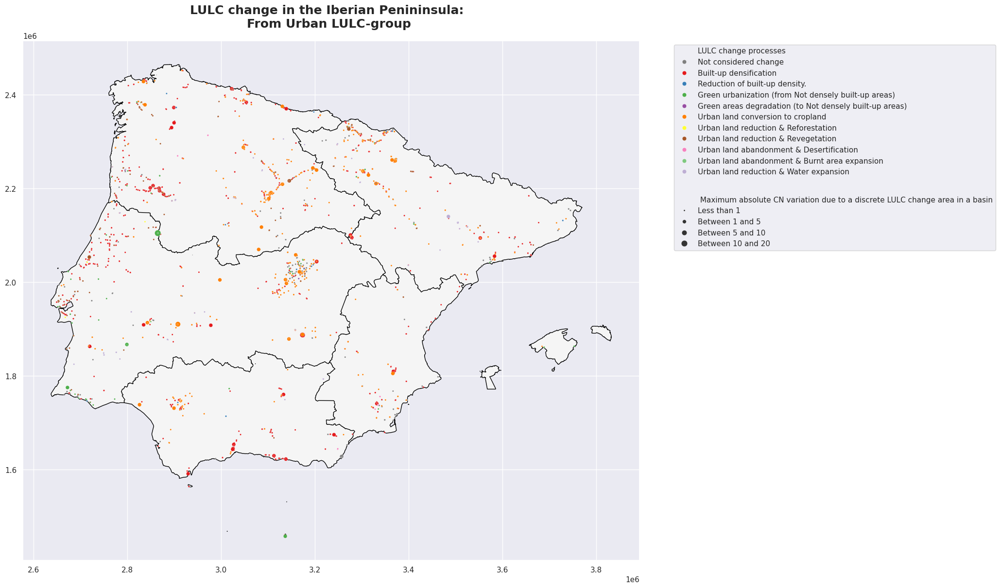

In [110]:
  # Create a figure and a grid of subplots
fig, ax = plt.subplots(1, 1, figsize=(20, 12), sharex=True, sharey=True, layout='constrained')


### Prepare color palette
colors = ['grey'] + list(sns.color_palette("Set1", 8)) + list(sns.color_palette("Accent", 2))


# Set both x and y axes to log scale

old_group = Iberia_CLC_CHA1218.loc[Iberia_CLC_CHA1218['Old_group']=='Urban']
  # Apply the function to create a new column
old_group = old_group.assign(New_column=old_group['Max_CN_var'].apply(assign_values)).rename(columns={'New_column': 'Marker_size'})
old_group = old_group.set_geometry(old_group.geometry.representative_point(), drop=False, inplace=False, crs=crs_IP )
old_group = old_group.sort_values('Change_code')
croquis.plot(ax=ax, color='whitesmoke', edgecolor='black', zorder = 1)

  # Draw each cell as a scatter point with varying size and color
sns.scatterplot(data=old_group, ax=ax,
        x=old_group.geometry.x, y=old_group.geometry.y, hue='Change_name', size='Marker_size', # style_order=changes,
        palette=colors,
        sizes=(5, 105), size_norm=(0,100))

# Add legend with offset
handles, labels = ax.get_legend_handles_labels()
labels = ['LULC change processes', ### Color labels
          'Not considered change',
          'Built-up densification',
          'Reduction of built-up density.',
          'Green urbanization (from Not densely built-up areas)',
          'Green areas degradation (to Not densely built-up areas)',
          'Urban land conversion to cropland',
          'Urban land reduction & Reforestation',
          'Urban land reduction & Revegetation',
          'Urban land abandonment & Desertification',
          'Urban land abandonment & Burnt area expansion',
          'Urban land reduction & Water expansion',
          '\n \n Maximum absolute CN variation due to a discrete LULC change area in a basin',  ### Marker size labels
          'Less than 1',
          'Between 1 and 5',
          'Between 5 and 10',
          'Between 10 and 20',
          'Between 20 and 100']

ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left')

# Set a figure title at a specific location
ax.set_title('LULC change in the Iberian Penininsula:  \nFrom Urban LULC-group ',fontdict={'fontsize':18, 'fontweight':'semibold'}, pad=20)

# Hide the axis titles (labels)
ax.set_xlabel('')
ax.set_ylabel('')

plt.show();

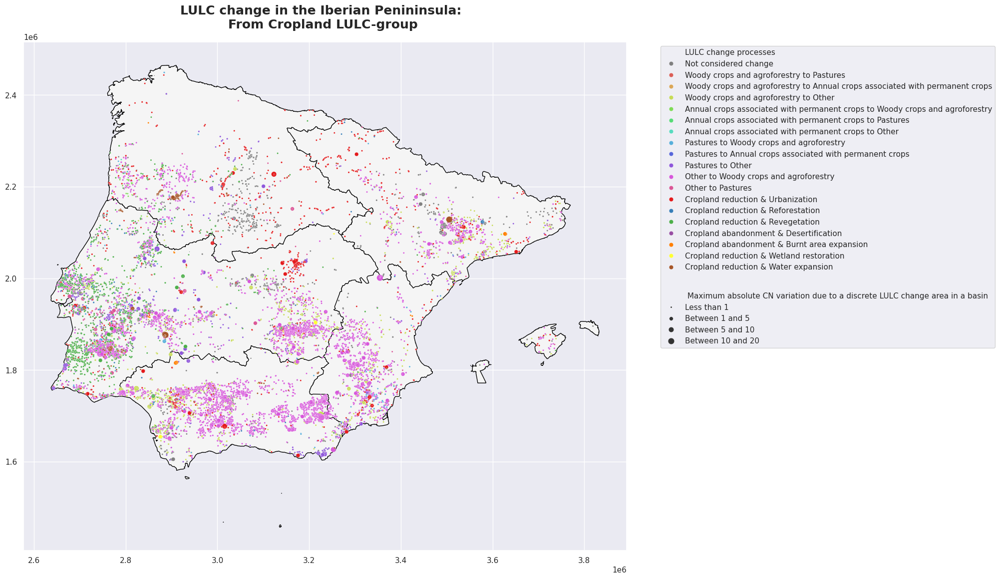

In [111]:
  # Create a figure and a grid of subplots
fig, ax = plt.subplots(1, 1, figsize=(20, 15), sharex=True, sharey=True, layout='constrained')

### Define color palette

colors = ['grey'] + list(sns.color_palette("hls", 11)) + list(sns.color_palette("Set1", 7))


# Set both x and y axes to log scale

old_group = Iberia_CLC_CHA1218.loc[Iberia_CLC_CHA1218['Old_group']=='Cropland']
  # Apply the function to create a new column
old_group = old_group.assign(New_column=old_group['Max_CN_var'].apply(assign_values)).rename(columns={'New_column': 'Marker_size'})
old_group = old_group.set_geometry(old_group.geometry.representative_point(), drop=False, inplace=False, crs=crs_IP )
old_group = old_group.sort_values('Change_code')
croquis.plot(ax=ax, color='whitesmoke', edgecolor='black', zorder = 1)

  # Draw each cell as a scatter point with varying size and color
sns.scatterplot(data=old_group, ax=ax,
        x=old_group.geometry.x, y=old_group.geometry.y, hue='Change_name', size='Marker_size',
        palette=colors,
        sizes=(5, 105), size_norm=(0,100))

# Add legend with offset
handles, labels = ax.get_legend_handles_labels()
labels = ['LULC change processes', ### Color labels
          'Not considered change',
          'Woody crops and agroforestry to Pastures',
          'Woody crops and agroforestry to Annual crops associated with permanent crops',
          'Woody crops and agroforestry to Other',
          'Annual crops associated with permanent crops to Woody crops and agroforestry',
          'Annual crops associated with permanent crops to Pastures',
          'Annual crops associated with permanent crops to Other',
          'Pastures to Woody crops and agroforestry',
          'Pastures to Annual crops associated with permanent crops',
          'Pastures to Other',
          'Other to Woody crops and agroforestry',
          'Other to Pastures',
          'Cropland reduction & Urbanization',
          'Cropland reduction & Reforestation',
          'Cropland reduction & Revegetation',
          'Cropland abandonment & Desertification',
          'Cropland abandonment & Burnt area expansion',
          'Cropland reduction & Wetland restoration',
          'Cropland reduction & Water expansion',
          '\n \n Maximum absolute CN variation due to a discrete LULC change area in a basin',  ### Marker size labels
          'Less than 1',
          'Between 1 and 5',
          'Between 5 and 10',
          'Between 10 and 20',
          'Between 20 and 100']


ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left')

# Set a figure title at a specific location
ax.set_title('LULC change in the Iberian Penininsula:  \nFrom Cropland LULC-group ',fontdict={'fontsize':18, 'fontweight':'semibold'}, pad=20)

# Hide the axis titles (labels)
ax.set_xlabel('')
ax.set_ylabel('')

plt.show();

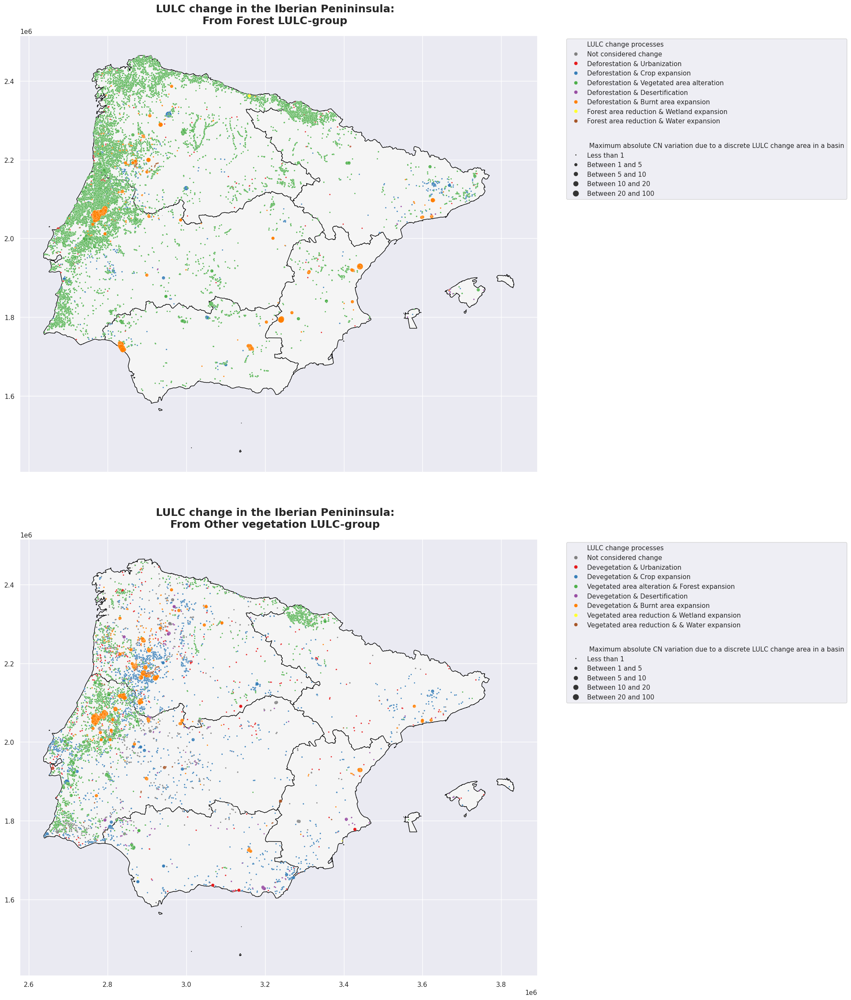

In [112]:
# Create a figure and a grid of subplots (2 rows, 3 columns)
fig, axes = plt.subplots(2, 1, figsize=(20, 24), sharex=True, sharey=True, layout='constrained')


groups = ['Forest', 'Other vegetation']
# Set both x and y axes to log scale
for ax, group in zip(axes.flatten(),groups):

  ### Define color palette

  colors = ['grey'] + list(sns.color_palette("Set1", 7))


  # Set both x and y axes to log scale

  old_group = Iberia_CLC_CHA1218.loc[Iberia_CLC_CHA1218['Old_group']==group]
    # Apply the function to create a new column
  old_group = old_group.assign(New_column=old_group['Max_CN_var'].apply(assign_values)).rename(columns={'New_column': 'Marker_size'})
  old_group = old_group.set_geometry(old_group.geometry.representative_point(), drop=False, inplace=False, crs=crs_IP )
  old_group = old_group.sort_values('Change_code')
  croquis.plot(ax=ax, color='whitesmoke', edgecolor='black', zorder = 1)

    # Draw each cell as a scatter point with varying size and color
  sns.scatterplot(data=old_group, ax=ax,
          x=old_group.geometry.x, y=old_group.geometry.y, hue='Change_name', size='Marker_size',
          palette=colors,
          sizes=(5, 105), size_norm=(0,100))

  # Add legend with offset
  handles, labels = ax.get_legend_handles_labels()
  labels = ['LULC change processes'] + labels[1:9] +  ['\n \n Maximum absolute CN variation due to a discrete LULC change area in a basin',  ### Marker size labels
          'Less than 1',
          'Between 1 and 5',
          'Between 5 and 10',
          'Between 10 and 20',
          'Between 20 and 100']



  ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left')

  # Set a figure title at a specific location
  title_str = 'LULC change in the Iberian Penininsula:  \nFrom ' + group + ' LULC-group  '
  ax.set_title(title_str, fontdict={'fontsize':18, 'fontweight':'semibold'}, pad=20)
  # Hide the axis titles (labels)
  ax.set_xlabel('')
  ax.set_ylabel('')

plt.show();

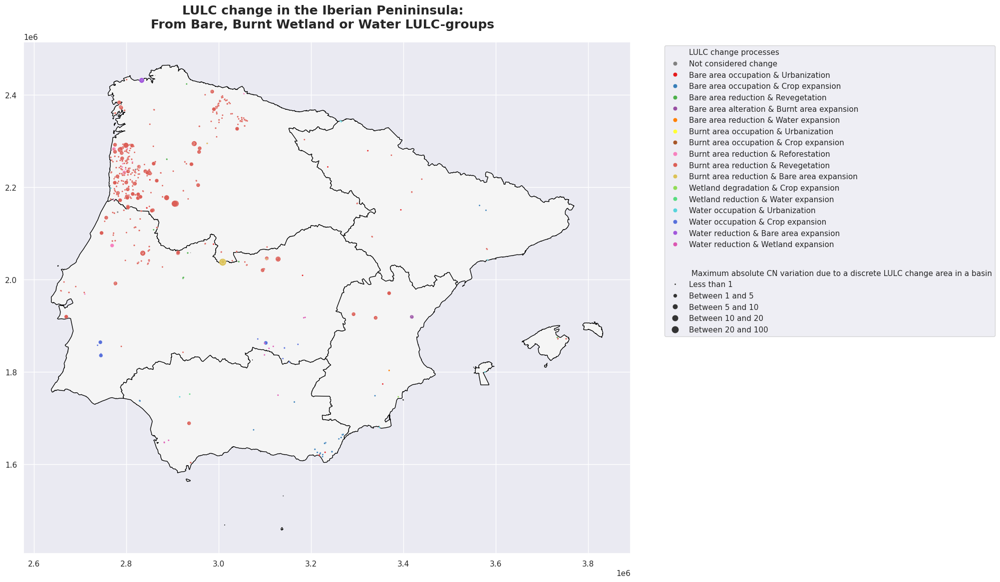

In [113]:
  # Create a figure and a grid of subplots
fig, ax = plt.subplots(1, 1, figsize=(20, 15), sharex=True, sharey=True, layout='constrained')

### Define color palette

colors = ['grey'] + list(sns.color_palette("Set1", 8)) + list(sns.color_palette("hls", 8))


# Set both x and y axes to log scale
# Filter the DataFrame based on multiple conditions
selected_groups = ['Bare', 'Burnt', 'Wetland', 'Water']
old_group = Iberia_CLC_CHA1218.loc[Iberia_CLC_CHA1218['Old_group'].isin(selected_groups)]
  # Apply the function to create a new column
old_group = old_group.assign(New_column=old_group['Max_CN_var'].apply(assign_values)).rename(columns={'New_column': 'Marker_size'})
old_group = old_group.set_geometry(old_group.geometry.representative_point(), drop=False, inplace=False, crs=crs_IP )
old_group = old_group.sort_values('Change_code')
croquis.plot(ax=ax, color='whitesmoke', edgecolor='black', zorder = 1)

  # Draw each cell as a scatter point with varying size and color
sns.scatterplot(data=old_group, ax=ax,
        x=old_group.geometry.x, y=old_group.geometry.y, hue='Change_name', size='Marker_size',
        palette=colors,
        sizes=(5, 105), size_norm=(0,100))

# Add legend with offset
handles, labels = ax.get_legend_handles_labels()
labels = ['LULC change processes'] + labels[1:18] + ['\n \n Maximum absolute CN variation due to a discrete LULC change area in a basin',  ### Marker size labels
          'Less than 1',
          'Between 1 and 5',
          'Between 5 and 10',
          'Between 10 and 20',
          'Between 20 and 100']


ax.legend(handles, labels, bbox_to_anchor=(1.05, 1), loc='upper left')

# Set a figure title at a specific location
ax.set_title('LULC change in the Iberian Penininsula:  \nFrom Bare, Burnt Wetland or Water LULC-groups  ',fontdict={'fontsize':18, 'fontweight':'semibold'}, pad=20)


# Hide the axis titles (labels)
ax.set_xlabel('')
ax.set_ylabel('')

plt.show();

### Compare the occurrence of LULC change processes in the major basin zones

In [114]:
# Sum the change area for each LULC change process in each major basin zone.
Affected_basins = Iberia_CLC_CHA1218.groupby(['Change_code','Change_name','namebasin'], sort=True).sum(numeric_only=True)
Affected_basins = Affected_basins.reset_index()
Affected_basins = Affected_basins.drop(columns=['Basins_Area_km2','Area_Ha','Relative_change_area_%'])


# Quantify the number of basins affected by each LULC change process.
Affected_basins['Affected_basins'] = Iberia_CLC_CHA1218.groupby(['Change_code','Change_name','namebasin'], sort=True)['Basin_ID'].nunique().reset_index().loc[:, 'Basin_ID']


# Quantify the corresponding percentage that each mbz represents in the Iberian Peninsula
#
total_IP = Affected_basins.groupby('Change_code').sum(numeric_only=True)

Affected_basins['IP_Change_area_km2'] = None
Affected_basins['IP_Affected_basins'] = None

for ind, code in zip(Affected_basins.index, Affected_basins['Change_code']):
  Affected_basins.at[ind,'IP_Change_area_km2'] = total_IP.loc[code,'Change_area_km2']
  Affected_basins.at[ind, 'IP_Affected_basins'] = total_IP.loc[code,'Affected_basins']


Affected_basins['per100_Change_area_km2'] = Affected_basins['Change_area_km2'] / Affected_basins['IP_Change_area_km2'] * 100
Affected_basins['per100_Affected_basins'] = Affected_basins['Affected_basins'] / Affected_basins['IP_Affected_basins'] * 100

Affected_basins

,Change_code,Change_name,namebasin,Change_area_km2,CNmaxVF,CNminVF,CN_change_upper_limit,CN_change_lower_limit,Max_CN_var,Affected_basins,IP_Change_area_km2,IP_Affected_basins,per100_Change_area_km2,per100_Affected_basins
0,999,Not considered change,Duero,171.125604,-7.84,-35.91,5.370920,-35.410491,47.770555,599,890.564066,2438,19.215418,24.569319
1,999,Not considered change,Ebro,112.540373,-5.61,-22.91,-9.273457,-47.832410,50.269691,280,890.564066,2438,12.636977,11.484824
2,999,Not considered change,Guadalquivir,107.390145,-5.96,-25.83,-3.590956,-32.096789,39.397817,307,890.564066,2438,12.058666,12.592289
3,999,Not considered change,Jucar,39.518372,-1.75,-7.42,-1.103853,-10.823188,11.817674,134,890.564066,2438,4.437454,5.496308
4,999,Not considered change,Tajo,459.989572,-46.20,-111.48,-12.851193,-131.112961,148.402448,1118,890.564066,2438,51.651486,45.85726
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,9200,Water occupation & Crop expansion,Guadalquivir,0.084341,-0.14,-0.38,-0.162287,-0.440492,0.440492,1,2.656426,11,3.174967,9.090909
201,9200,Water occupation & Crop expansion,Tajo,2.572085,-1.78,-6.14,-2.555622,-9.156352,9.156352,10,2.656426,11,96.825033,90.909091
202,9500,Water reduction & Bare area expansion,Duero,0.035810,-3.75,-3.75,-5.690035,-5.690035,5.690035,4,0.03581,4,100.0,100.0
203,9800,Water reduction & Wetland expansion,Guadalquivir,0.539541,-0.20,-0.20,-0.059112,-0.059112,0.059112,4,2.280446,8,23.659427,50.0


In [115]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots


# Create subplots with different axes
fig = make_subplots(rows=1, cols=4, subplot_titles=('Change Area (%)', 'Change Area (km^2)', 'Affected basins (%)', 'Affected basins'), horizontal_spacing=0.01, vertical_spacing=0.01, shared_yaxes=True)

small2big = ['Jucar', 'Guadalquivir',  'Ebro', 'Duero', 'Tajo']
COLORS1 = list([px.colors.qualitative.Set1[1] , px.colors.qualitative.Set1[4], px.colors.qualitative.Set1[2] , px.colors.qualitative.Set1[0] , px.colors.qualitative.Set1[3]])
COLOR2 = px.colors.qualitative.T10[3]
for mbz_name, COLOR1 in zip(small2big, COLORS1):
  # Add traces for each variable
  fig.add_trace(go.Bar(x=Affected_basins['per100_Change_area_km2'].loc[Affected_basins['namebasin']==mbz_name], y = Affected_basins['Change_name'].loc[Affected_basins['namebasin']==mbz_name],
                       name=mbz_name, marker=dict(color=COLOR1), orientation='h'),
                row=1, col=1)
  fig.add_trace(go.Bar( x=Affected_basins['per100_Affected_basins'].loc[Affected_basins['namebasin']==mbz_name], y = Affected_basins['Change_name'].loc[Affected_basins['namebasin']==mbz_name],
                       name=mbz_name, marker=dict(color=COLOR1), orientation='h'),
                row=1, col=3)
  fig.add_trace(go.Bar( x=Affected_basins['Change_area_km2'].loc[Affected_basins['namebasin']==mbz_name], y = Affected_basins['Change_name'].loc[Affected_basins['namebasin']==mbz_name],
                       name=mbz_name, customdata=Affected_basins['IP_Change_area_km2'].loc[Affected_basins['namebasin']==mbz_name],
                        hovertemplate='<b>%{y}</b><br>' + 'Change area in %{fullData.name} MBZ (km^2): %{x:.2f}<br>' + 'Change area in Iberian Peninsula (km^2): %{customdata:.2f}<br>'  + '<extra>%{fullData.name}</extra>', marker=dict(color=COLOR2), orientation='h'),
                row=1, col=2)
  fig.add_trace(go.Bar( x=Affected_basins['Affected_basins'].loc[Affected_basins['namebasin']==mbz_name], y = Affected_basins['Change_name'].loc[Affected_basins['namebasin']==mbz_name],
                       name=mbz_name, customdata=Affected_basins['IP_Affected_basins'].loc[Affected_basins['namebasin']==mbz_name],
                        hovertemplate='<b>%{y}</b><br>' + 'Affected basins in %{fullData.name} MBZ: %{x:.2f}<br>' + 'Affected basins in Iberian Peninsula: %{customdata:.2f}<br>'  + '<extra>%{fullData.name}</extra>', marker=dict(color=COLOR2), orientation='h'),
                row=1, col=4)


# Define color map
order = list(change_names['Change_process_full_name'])
order.reverse()
# Reorder the categories on the y-axis
fig.update_yaxes(categoryorder='array', categoryarray=order)


# Update xaxis2 and xaxis4 to log scale
fig.update_xaxes(type="log", row=1, col=2)
fig.update_xaxes(type="log", row=1, col=4)

# Update the layout to enhance the aesthetics
fig.update_layout(barmode= 'stack', height=1400, margin=dict(l=50, r=50, t=50, b=50))

# Hide legends for traces in other subplots
for i in range(2, 5):
    fig.update_traces(showlegend=False, row=1, col=i)


# Show plot
fig.show()

### Save the Geopackage in Drive

In [116]:
# Save the GeoDataFrames to a Geopackage using the pyogrio engine
Iberia_CLC_CHA1218.to_file('/content/drive/MyDrive/Iberia_project/03_Results/Iberia_CLC_CHA_2012_2018.gpkg', driver='GPKG', layer='subbasins_change', engine= 'pyogrio')